# Clustering Barcelona neighborhoods

### by Ian Riera Smolinska


This project is the final delivery for the [Applied Data Science Capstone](https://www.coursera.org/learn/applied-data-science-capstone) course. This course is the last one to complete the [IBM Data Science Professional Certificate](https://www.coursera.org/professional-certificates/ibm-data-science).

In addition to this notebook that presents the executed codes for the data obtention, analysis and modelling, you can acces to the following documents:
- [Presentation]()
- [Report]()
- [Blog]()


## Table of contents
* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Age scope](#age)
* [Nationality scope](#nationality)
* [Political scope](#politics)
* [Household income scope](#income)
* [Unemployment scope](#unemployment)
* [Commercial venues scope](#commercial)
* [Foresquare scope](#foresquare)
* [COVID-19](#covid)
* [Methodology](#methodology)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)



## Introduction: Business Problem <a name="introduction"></a>

The goal of this project is to cluster the neighborhoods of the city of **Barcelona** basing on demographic, economic and commercial characteristics to be able to understand the context of the city itself prior opening a business in it. 

Since the official statistics are usually objective, Foresquare will be used to obtain the commercial venues that people visited and rated in the application. 

As the administrative division splits the city in **10 districts**, the neighborhoods will be grouped in 10 different clusters basing on the mentioned parameters individually. Then the correlation between the different clusterings will be calculated to try and find out dependencies. 

Finally, taking into account all the parameters, a final division of the city will be established.

## Data <a name="data"></a>

The statistics of the neighborhoods that will be analyzed can be obtained from the webpage of the **Barcelona's city council**:
* [Nationality](https://www.bcn.cat/estadistica/castella/dades/barris/tpob/pad/ine/a2019/ine17.htm)
* [Unemployment](https://www.bcn.cat/estadistica/castella/dades/barris/ttreball/atur/durada/durbar19.htm)
* [Local elections voting.](https://www.bcn.cat/estadistica/castella/dades/barris/telec/loc/a2019.htm)
* [Age](https://www.bcn.cat/estadistica/castella/dades/barris/tpob/pad/ine/a2019/ine02.htm)
* [Available Family Income index.](https://www.bcn.cat/estadistica/castella/dades/barris/economia/renda/rdfamiliar/a2017.htm)
* [Street-level commercial venues](https://www.bcn.cat/estadistica/castella/dades/barris/economia/tacteco/gacbarri19.htm)

In addition, we will be using the **Foursquare API** to locate the different commercial venues in the city.

To represent the neighborhoods on a map, the geolocation information is required:
[Barcelona geodata](https://github.com/IanRiera/Coursera_Capstone/blob/master/Final_Project/bcn_hoods.geojson)


For every one of the mentioned webpages, the same process will be repeated:
- Brief analysis of each parameter.
- Segmentation of the city.
- Map representation of the new distribution.

Note that any of those topics combination would provide material for a project on its own. Is not the goal of this project to make and advanced analysis but to present the topics and several tools for data analysis and visualization.

## Age scope<a name="age"></a>

The first scope will be basing on the age of the citizens of Barcelona. As is the first one, functions will be defined to reuse them for the next scenarios.

In [1]:
# import the required libraries
import pandas as pd # library for data analsysis
import numpy as np # library for data analsysis
import requests # library to handle requests
from bs4 import BeautifulSoup # library for scrapping
import re # library for regular expresions

print('Libraries imported.')

Libraries imported.


### 1. Data obtention. 
In order to obtain the information on the table we will do web scrapping using the Beautiful Soup library. The information will be saved in Pandas Dataframes.

In [2]:
# function to get the column names
def get_headers(table):
    # to get the headers for the column names
    table_data=""
    
    flag = True
    # html table rows headers stand as 'tr'
    for tr in table.find_all('tr'):
        row_data=""
        # for each row, we will save every column value separated by ';' so we can easily split it afterwards
        # after webpage inspection, it is observed that the headers of the columns are of the class: 'WhadsColVar1' 
        if flag:
            for tds in tr.find_all('td', {'class':'WhadsColVar1'}):
                row_data = row_data+";"+tds.text    
            table_data = table_data+row_data[1:] 
            print
            if table_data != "":
                    flag = False
            
    # define the dataframe columns
    column_names = [table_data.split(';')] 
    
    return column_names

In [3]:
# function to create a dataframe with the information from the table
def create_dataframe(table):
    pd.set_option('display.max_rows', None)
    table_data=""
    for tr in table.find_all('tr'):
        row_data=""
        for tds in tr.find_all('td'):
            row_data=row_data+";"+tds.text

        table_data=table_data+row_data[1:]+'\n'
        
    # to remove the no interest data at the top rows (decided by inspecting the webpage html code)
    table_data = table_data[table_data.find("BARCELONA"):]

    # get the table into rows
    table_rows = table_data.split('\n')

    # fill the dataframe with the information in each row
    row_df = pd.DataFrame([table_rows[0].split(';')])
    i = 0
    for row in table_rows[1:]:
        data = row.split(';')
        row_df = row_df.append(pd.DataFrame([data]),ignore_index=True)
        i+=1
        if i >74:
            break

    return row_df

In [4]:
# function to webscrape the web page, obtain the headers, create and fill the dataframe
def web_to_dataframe(web_page):
    # get the webpage we want to analyze
    source = requests.get(web_page, verify=False).text
    
    # apply the scraper on the webpage
    soup = BeautifulSoup(source)
  
    # extract the table from the webpage
    table = soup.find('table')
       
    df = create_dataframe(table)
        
    headers = get_headers(table)

    df.columns = headers
    df.columns = df.columns.get_level_values(0) # to ensure it is not a multi-index
    
    return df

In [5]:
# now we can easily use the created functions
web_age = 'http://www.bcn.cat/estadistica/castella/dades/barris/tpob/pad/ine/a2019/ine02.htm'

df_age = web_to_dataframe(web_age)

df_age.head()

C:\Users\Ian\anaconda3\lib\site-packages\urllib3\connectionpool.py:1004: InsecureRequestWarning: Unverified HTTPS request is being made to host 'www.bcn.cat'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,


,Dto. Barrio,TOTAL,0 años,1 año,2 años,3 años,4 años,5 años,6 años,7 años,...,86 años,87 años,88 años,89 años,90 años,91 años,92 años,93 años,94 años,95 años
0,BARCELONA,1.636.762,12.584,13.409,13.299,13.618,13.531,13.417,13.844,13.840,...,9.365,8.533,7.863,6.521,5.498,4.733,4.032,3.184,2.497,1.835
1,,,,,,,,,,,...,,,,,,,,,,
2,1 1. el Raval,47.353,415,467,408,404,374,383,425,442,...,143,122,100,100,90,73,71,62,42,24
3,1 2. el Barri Gòtic,18.629,116,115,91,96,88,97,96,96,...,47,58,55,39,26,31,31,26,23,16
4,1 3. la Barceloneta,14.857,77,96,78,85,73,84,65,65,...,86,71,75,43,37,43,26,21,28,13


### 2. Data processing:

At a first glance we can observe that table has some imperfections. The first row can be calculated easily afterwards so we will remove it. The empty rows or with NaN values are also dropped. We can observe that the first column includes the district id and the neighborhood's id and name, so we will split them in 3 columns. We will also remove the '.' from the numbers and ensure all the numerical values are presented as integers.

In [6]:
def process_data(df):
    # drop missing values, empty row and Barcelona totals row, as we can calculate the values when we need them
    df = df.dropna()
    df.drop(df.index[1],inplace=True)
    df.drop(df.index[0],inplace=True)
    # reset index
    df.reset_index(drop=True, inplace=True)

    # trim to remove spaces
    df = df.applymap(lambda x: x.strip() if isinstance(x, str) else x)
    df = df.rename(columns=lambda x: x.strip())
    
    # drop empty labeled columns
    if '' in df.columns:
        df = df.drop([''],axis=1)

    df.rename(columns={"TOTAL":"Population"}, inplace = True)
    
    # split the content of first column into multiples to get district and neighborhood id's
    s = df.iloc[:,0]
    new = s.str.split( n = 1, expand = True) 

    # add column to desired position
    df.insert(0, 'District', new[0])
    df.insert(1, 'Neighborhood', new[1])

    #drop orignal column
    df.drop(df.columns[[2]], axis = 1, inplace = True)
    
    # iterate again for neigborhood column to get neighborhood id
    s = df.iloc[:,1]
    new = s.str.split(pat = '.', n = 1, expand = True) 

    df.insert(1, 'Neighborhood_ID', new[0])
    df.insert(2, 'Neighborhood_name', new[1])

    df.drop(df.columns[[3]], axis = 1, inplace = True)
    
    # drop the columns where some value is null
    df.dropna(how='any', axis=1)
    
    # as numbers are presented as 1.000,00 convert to 1000.00 and then to int
    df = df.apply(lambda x: x.str.replace('.',''))
    df = df.apply(lambda x: x.str.replace(',','.'))
    df = df.applymap(lambda x: int(float(x)) if x.isnumeric() else x)
    
    return df

In [7]:
df_age_clean = process_data(df_age)

# some extra processing for this scenario, remove 'años' from the columns name
df_age_clean.rename(columns=lambda x:re.sub(r'\b\w*año\w*\b', '', x), inplace=True)

df_age_clean.head()

C:\Users\Ian\anaconda3\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,District,Neighborhood_ID,Neighborhood_name,Population,0,1,2,3,4,5,...,86,87,88,89,90,91,92,93,94,95
0,1,1,el Raval,47353,415,467,408,404,374,383,...,143,122,100,100,90,73,71,62,42,24
1,1,2,el Barri Gòtic,18629,116,115,91,96,88,97,...,47,58,55,39,26,31,31,26,23,16
2,1,3,la Barceloneta,14857,77,96,78,85,73,84,...,86,71,75,43,37,43,26,21,28,13
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,139,161,140,142,133,137,...,104,81,85,50,56,45,29,23,29,20
4,2,5,el Fort Pienc,32349,251,230,233,252,257,239,...,185,185,157,144,108,102,72,72,53,49


We will also create a Global dataframe with the city information, let this be the district id, neighborhood's id and name, and the number of inhabitants. We will be adding summarized information on this dataframe, as well as the different cluster labels.

In [8]:
df_BCN = df_age_clean.iloc[:,:4]

# calculate the percentage of population in each neighborhood
population_total = df_BCN["Population"].sum()
df_BCN['Population_%'] = round(df_BCN['Population'].div(population_total)*100,2)
df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%
0,1,1,el Raval,47353,2.89
1,1,2,el Barri Gòtic,18629,1.14
2,1,3,la Barceloneta,14857,0.91
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38
4,2,5,el Fort Pienc,32349,1.98


We can extract for example which percentatge of the city population lives in every neighborhood, and find the must populated and the least populated ones.

In [9]:
max_pop = int(df_BCN['Population'].max())
max_pop_perc= float(df_BCN['Population_%'].max())
max_pop_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Population'].idxmax(axis = 0)])

min_pop = int(df_BCN['Population'].min())
min_pop_perc= float(df_BCN['Population_%'].min())
min_pop_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Population'].idxmin(axis = 0)])

print("The most populated neighborhood in Barcelona is {} with the {:.2f}  of the population, {:d} inhabitants. ".format(max_pop_hood, max_pop_perc, max_pop))
print("The least populated neighborhood in Barcelona is {} with the {:.2f}  of the population, {:d} inhabitants. ".format(min_pop_hood, min_pop_perc, min_pop))

The most populated neighborhood in Barcelona is  la Nova Esquerra de l'Eixample with the 3.55  of the population, 58032 inhabitants. 
The least populated neighborhood in Barcelona is  la Clota with the 0.04  of the population, 683 inhabitants. 


And now we can make the first reorganization of the neighborhoods basing on the population %. As previously mentioned we will separate into 10 bins basing on the different parameters, in order to not lose the track of the values of the bins a dataframe is created.

In [10]:
df_bins = pd.DataFrame(np.arange(1,11), columns=['Bin_ID'])
df_bins

,Bin_ID
0,1
1,2
2,3
3,4
4,5
5,6
6,7
7,8
8,9
9,10


In [11]:
# split the data range into 10 bins
df_BCN['Population_ID'], population_bins = pd.cut(np.asarray(df_BCN['Population_%']),10,labels=np.arange(1,11), retbins=True)

df_bins['Population_%'] = population_bins[:10].round(2)

df_BCN.head()


,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID
0,1,1,el Raval,47353,2.89,9
1,1,2,el Barri Gòtic,18629,1.14,4
2,1,3,la Barceloneta,14857,0.91,3
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4
4,2,5,el Fort Pienc,32349,1.98,6


### Choropleth maps

The tables might provide a useful source for analysis, but not as much for visual presentation. Therefore, we will be reproducing the differents clusters on a map of Barcelona, using the Folium library.

First of all, the representation of the actual administrative division.

In [12]:
!conda install -c conda-forge folium=0.5.0 --yes

Solving environment: ...working... 
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::certifi-2019.11.28-py37_0, anaconda/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::certifi-2019.11.28-py37_0, anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::ca-certificates-2020.1.1-0
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::certifi-2019.11.28-py37_0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::certifi-2019.11.28-py37_0, defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::ca-certificates-2020.1.1-0, defaults/win-64::certifi-2019.11.28-py37_0, defaults/win-64::openssl-1.1.1d-he774522_4
  - defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::certifi-2019.11.28-py37_0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::certifi-2019.11.28-py37_0
  - anaconda

In [13]:
!conda install -c conda-forge geopy --yes 

Solving environment: ...working... 
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::certifi-2019.11.28-py37_0, anaconda/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::certifi-2019.11.28-py37_0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::certifi-2019.11.28-py37_0, anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::ca-certificates-2020.1.1-0
  - anaconda/win-64::certifi-2019.11.28-py37_0, defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::certifi-2019.11.28-py37_0
  - defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::certifi-2019.11.28-py37_0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::certifi-2019.11.28-py37_0
  - anaconda

We will need the coordinates of the city and the geojson file with the neighborhoods boundaries.

In [14]:
import urllib.request
import folium
from branca.element import Template, MacroElement
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
from geopy.exc import GeocoderTimedOut

In [15]:
address = 'Barcelona, Catalonia'
geolocator = Nominatim(user_agent="bcn_explorer")

# geopy might fail to consistently work, so you need to try persistently
def do_geocode(address, attempt=1, max_attempts=5):
    try:
        return geolocator.geocode(address)
    except GeocoderTimedOut:
        if attempt <= max_attempts:
            return do_geocode(address, attempt=attempt+1)
        raise


location = do_geocode(address)
latitude = location.latitude
longitude = location.longitude

print('The geograpical coordinates of Barcelona are {}, {}.'.format(latitude, longitude))

The geograpical coordinates of Barcelona are 41.3828939, 2.1774322.


In [17]:
url = 'https://github.com/IanRiera/Coursera_Capstone/raw/master/Final_Project/bcn_hood.geojson'
filename = 'bcn.geojson'
urllib.request.urlretrieve(url, filename)

('bcn.geojson', <http.client.HTTPMessage at 0x1be64ce1248>)

In [18]:
# the neighborhoods will be colored basing on the cluster id. The same color palet will be used from yellow (1) to red (10)
def my_color_function(feature,column_name):
    color_palette = ['#ffffb4','#ffff6a', '#ffdc2b', '#ffa74f', '#ff8a15', '#ff8080', '#ff4040', '#ff0000','#cd0040', '#9a0080']
    # gets the value from the id column name and returns the associated color to this id
    color = df_BCN[[column_name]].loc[df_BCN['Neighborhood_ID'] == feature['properties']['Neighborhood_ID']].values[0][0]-1
    
    return color_palette[color]

In [19]:
# creation of a city map using the column
def choropleth_map(geo_data,column_name, latitude, longitude):
    # create a plain world map
    colored_map = folium.Map(location=[latitude, longitude], zoom_start=12)

    folium.GeoJson(
        geo_data,
        style_function=lambda feature: {
            'fillColor': my_color_function(feature,column_name),
            'fillOpacity' :0.7,
            'color' : 'black',
            'weight' : 1,
            'dashArray' : '1, 1'
            }
        ).add_to(colored_map)
    
    # to add a legend
    template = """
    {% macro html(this, kwargs) %}

    <!doctype html>
    <html lang="en">
    <head>
      <meta charset="utf-8">
      <meta name="viewport" content="width=device-width, initial-scale=1">
      <title>jQuery UI Draggable - Default functionality</title>
      <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

      <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
      <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

      <script>
      $( function() {
        $( "#maplegend" ).draggable({
                        start: function (event, ui) {
                            $(this).css({
                                right: "auto",
                                top: "auto",
                                bottom: "auto"
                            });
                        }
                    });
    });

      </script>
    </head>
    <body>


    <div id='maplegend' class='maplegend' 
        style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
         border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>

    <div class='legend-title'>Cluster - ID</div>
    <div class='legend-scale'>
      <ul class='legend-labels'>
        <li><span style='background:#ffffb4;opacity:0.7;'></span>1</li>
        <li><span style='background:#ffff6a;opacity:0.7;'></span>2</li>
        <li><span style='background:#ffdc2b;opacity:0.7;'></span>3</li>
        <li><span style='background:#ffa74f;opacity:0.7;'></span>4</li>
        <li><span style='background:#ff8a15;opacity:0.7;'></span>5</li>
        <li><span style='background:#ff8080;opacity:0.7;'></span>6</li>
        <li><span style='background:#ff4040;opacity:0.7;'></span>7</li>
        <li><span style='background:#ff0000;opacity:0.7;'></span>8</li>
        <li><span style='background:#cd0040;opacity:0.7;'></span>9</li>
        <li><span style='background:#9a0080;opacity:0.7;'></span>10</li>
        
      </ul>
    </div>
    </div>

    </body>
    </html>

    <style type='text/css'>
      .maplegend .legend-title {
        text-align: left;
        margin-bottom: 5px;
        font-weight: bold;
        font-size: 90%;
        }
      .maplegend .legend-scale ul {
        margin: 0;
        margin-bottom: 5px;
        padding: 0;
        float: left;
        list-style: none;
        }
      .maplegend .legend-scale ul li {
        font-size: 80%;
        list-style: none;
        margin-left: 0;
        line-height: 18px;
        margin-bottom: 2px;
        }
      .maplegend ul.legend-labels li span {
        display: block;
        float: left;
        height: 16px;
        width: 30px;
        margin-right: 5px;
        margin-left: 0;
        border: 1px solid #999;
        }
      .maplegend .legend-source {
        font-size: 80%;
        color: #777;
        clear: both;
        }
      .maplegend a {
        color: #777;
        }
    </style>
    {% endmacro %}"""

    macro = MacroElement()
    macro._template = Template(template)

    colored_map.get_root().add_child(macro)
    
    return colored_map

In [20]:
bcn_geo = r'bcn.geojson'
bcn_administrative_map = choropleth_map(bcn_geo, 'District',latitude,longitude)
bcn_administrative_map

Now we can compare with the division by population percentage.

In [21]:
bcn_population_map = choropleth_map(bcn_geo, 'Population_ID',latitude,longitude)
bcn_population_map

In [22]:
# to better understand the legend
df_bins[['Bin_ID','Population_%']]

,Bin_ID,Population_%
0,1,0.04
1,2,0.39
2,3,0.74
3,4,1.09
4,5,1.44
5,6,1.80
6,7,2.15
7,8,2.50
8,9,2.85
9,10,3.20


### 3. Data analysis

We go back to the age scenario. We will calculate the mean age per neighborhood and find the one with the youngest population and the one with the eldest.

In [23]:
# create series using numpy range from 0.5 instead of 0, as if not it would not count the newborns
series = pd.Series(np.arange(0.5, 96.5 ,1))

# multiply by rows, the age for the population in that range
df_sum_age = df_age_clean.iloc[:,4:].mul(np.asarray(series), axis=1)

#df_mean_age = df_age.iloc[:,:4]
# calculate the mean age for every neighborhood
df_BCN['Mean_age'] = (df_sum_age.sum(axis=1)/df_BCN['Population']).astype(int)

df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age
0,1,1,el Raval,47353,2.89,9,38
1,1,2,el Barri Gòtic,18629,1.14,4,39
2,1,3,la Barceloneta,14857,0.91,3,43
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40
4,2,5,el Fort Pienc,32349,1.98,6,44


In [24]:
old_pop = int(df_BCN['Mean_age'].max())
old_pop_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Mean_age'].idxmax(axis = 0)])

young_pop = int(df_BCN['Mean_age'].min())
young_pop_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Mean_age'].idxmin(axis = 0)])

print("The neighborhood in Barcelona with the oldest population is {} with a mean age of {:d}. ".format(old_pop_hood, old_pop))
print("The neighborhood in Barcelona with the youngest population is {} with a mean age of {:d}. ".format(young_pop_hood, young_pop))

The neighborhood in Barcelona with the oldest population is  Canyelles with a mean age of 48. 
The neighborhood in Barcelona with the youngest population is  el Raval with a mean age of 38. 


Next let's compare the age pyramide for both the youngest and oldest neighborhoods, in relation with the Barcelona one.

In [25]:
# use the inline backend to generate the plots within the browser
%matplotlib inline 
import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('seaborn-whitegrid') # optional: for ggplot-like style

In [26]:
# for the plot x axis
ages = list(map(str, range(0, 96)))

# let's get the two neighborhoods of interest
df_age_bars = pd.DataFrame(df_age_clean.iloc[df_BCN['Mean_age'].idxmax(axis = 0),2:]).transpose()
df_age_bars= df_age_bars.append(pd.DataFrame(df_age_clean.iloc[df_BCN['Mean_age'].idxmin(axis = 0),2:]).transpose(), ignore_index = True)

df_age_bars.drop(columns="Population",inplace=True)

# add the Barcelona total row
df_age_bars = df_age_bars.append(df_age_clean.iloc[:,4:].sum(axis=0),ignore_index = True)
df_age_bars.iloc[2,0] = "Barcelona"

df_age_bars.head()

,Neighborhood_name,0,1,2,3,4,5,6,7,8,...,86,87,88,89,90,91,92,93,94,95
0,Canyelles,32,49,46,58,46,55,51,62,49,...,47,30,28,41,16,20,9,10,9,5
1,el Raval,415,467,408,404,374,383,425,442,433,...,143,122,100,100,90,73,71,62,42,24
2,Barcelona,12584,13409,13299,13618,13531,13417,13844,13840,13721,...,9365,8533,7863,6521,5498,4733,4032,3184,2497,1835


In [27]:
# make it percentual for a more visual representation
rows = pd.Series(df_age_bars.iloc[:,1:].sum(axis=1)*0.01)
df_age_bars_norm = df_age_bars.copy()
df_age_bars_norm.iloc[:,1:]= df_age_bars.iloc[:,1:].div(rows,axis=0)

df_age_bars_norm.head()

,Neighborhood_name,0,1,2,3,4,5,6,7,8,...,86,87,88,89,90,91,92,93,94,95
0,Canyelles,0.465658,0.713038,0.669383,0.844005,0.669383,0.800349,0.742142,0.902212,0.713038,...,0.683935,0.436554,0.407451,0.596624,0.232829,0.291036,0.130966,0.145518,0.130966,0.072759
1,el Raval,0.877397,0.987336,0.862598,0.854141,0.790714,0.809742,0.898539,0.934481,0.915453,...,0.302332,0.257934,0.211421,0.211421,0.190279,0.154337,0.150109,0.131081,0.0887968,0.050741
2,Barcelona,0.770787,0.821319,0.814582,0.834121,0.828792,0.821809,0.847964,0.847719,0.84043,...,0.573619,0.522658,0.481619,0.39942,0.33676,0.289903,0.246965,0.195024,0.152945,0.112396


In [28]:
# to be sure it adds up 100%
df_age_bars_norm.iloc[:,1:].sum(axis=1)

0    100.0
1    100.0
2    100.0
dtype: float64

Matplotlib will be used for representing the bar graphic.

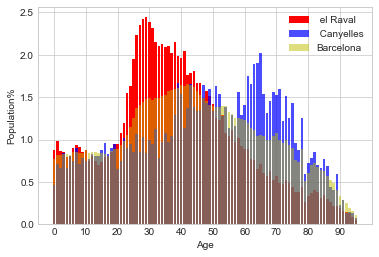

In [29]:
# generate plot
plt.bar(ages, df_age_bars_norm.iloc[1,1:],
        color='r', alpha=1, label=df_age_bars.iloc[1,0],align='center')

plt.bar(ages, df_age_bars_norm.iloc[0,1:],  
        color='b',alpha=0.7, label=df_age_bars.iloc[0,0],align='center')

plt.bar(ages, df_age_bars_norm.iloc[2,1:],
        color='y', alpha=0.5, label=df_age_bars.iloc[2,0],align='center')


plt.xticks(list(map(str, range(0, 96,10))) )

plt.legend()
plt.xlabel('Age')
plt.ylabel('Population%')
plt.show()

### 4. Clustering
We will divede the city by mean age, being 1 the minimum mean age (el Raval) and 10 the maximum (Canyelles).

In [30]:
# split the data range into 10 bins
df_BCN['Age_ID'], age_bins = pd.cut(np.asarray(df_BCN['Mean_age']),10,labels=np.arange(1,11), retbins=True)
df_bins['Mean_age'] = age_bins[:10].astype(int)
df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID
0,1,1,el Raval,47353,2.89,9,38,1
1,1,2,el Barri Gòtic,18629,1.14,4,39,1
2,1,3,la Barceloneta,14857,0.91,3,43,5
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2
4,2,5,el Fort Pienc,32349,1.98,6,44,6


### 5. Visual representation
The choropleth map is created, being yellow the youngest and purple the eldest.

In [31]:
bcn_age_map = choropleth_map(bcn_geo, 'Age_ID',latitude,longitude)
bcn_age_map

In [32]:
# to understand better the legend
df_bins[['Bin_ID','Mean_age']]

,Bin_ID,Mean_age
0,1,37
1,2,39
2,3,40
3,4,41
4,5,42
5,6,43
6,7,44
7,8,45
8,9,46
9,10,47


## Nationality scope<a name="nationality"></a>

This scope will analyze the immigrant population registered in each neighborhood.


### 1. Data obtention. 

In [33]:
web_nat = 'https://www.bcn.cat/estadistica/castella/dades/barris/tpob/pad/ine/a2019/ine17.htm'

df_nat = web_to_dataframe(web_nat)

df_nat.head()

C:\Users\Ian\anaconda3\lib\site-packages\urllib3\connectionpool.py:1004: InsecureRequestWarning: Unverified HTTPS request is being made to host 'www.bcn.cat'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,


,Dto. Barrio,TOTAL,España,Italia,Francia,Reino Unido,Rusia,Alemania,Rumanía,Portugal,...,Camboya,Tadyikistán,Bahréin,Maldivas,Laos,Omán,Resto de Asia,,Australia,Nueva Zelanda
0,BARCELONA,1.636.762,1.316.380,34.287,15.757,7.899,7.395,7.127,7.097,5.014,...,6,6,5,3,2,1,175,,399,101
1,,,,,,,,,,,...,,,,,,,,,,
2,1 1. el Raval,47.353,23.154,1.831,813,536,197,377,264,204,...,0,3,0,0,0,0,4,,13,4
3,1 2. el Barri Gòtic,18.629,8.375,1.156,598,374,162,297,179,113,...,0,0,0,0,0,0,8,,31,4
4,1 3. la Barceloneta,14.857,9.245,1.084,296,209,100,203,81,137,...,0,0,1,0,0,0,1,,20,5


### 2. Data processing

In [34]:
df_nat_clean = process_data(df_nat)

df_nat_clean.head()

C:\Users\Ian\anaconda3\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,District,Neighborhood_ID,Neighborhood_name,Population,España,Italia,Francia,Reino Unido,Rusia,Alemania,...,Myanmar,Camboya,Tadyikistán,Bahréin,Maldivas,Laos,Omán,Resto de Asia,Australia,Nueva Zelanda
0,1,1,el Raval,47353,23154,1831,813,536,197,377,...,0,0,3,0,0,0,0,4,13,4
1,1,2,el Barri Gòtic,18629,8375,1156,598,374,162,297,...,0,0,0,0,0,0,0,8,31,4
2,1,3,la Barceloneta,14857,9245,1084,296,209,100,203,...,0,0,0,1,0,0,0,1,20,5
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,12738,1624,780,543,208,382,...,0,0,0,2,0,0,0,1,40,10
4,2,5,el Fort Pienc,32349,24522,1114,551,235,110,200,...,0,0,0,0,0,0,1,4,6,1


The country names appear in Spanish, but we want them in English so we will use a translate library. As google translator API gives some problems with the quota and missfunctions, we will use an alternative translator: Yandex translate API.

In [35]:
!pip install yandex.translate

In [36]:
from yandex_translate import YandexTranslate

# Introduce credentials as translator = YandexTranslate(#Api key found on https://translate.yandex.com/developers/keys)

In [38]:
df_nat_clean = df_nat_clean.rename(columns=lambda x: translator.translate(x, 'es-en')["text"][0])

df_nat_clean.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Spain,Italy,France,Uk,Russia,Germany,...,Myanmar,Cambodia,Tajikistan,Bahrain,Maldives,Laos,Oman,Rest of Asia,Australia,New Zealand
0,1,1,el Raval,47353,23154,1831,813,536,197,377,...,0,0,3,0,0,0,0,4,13,4
1,1,2,el Barri Gòtic,18629,8375,1156,598,374,162,297,...,0,0,0,0,0,0,0,8,31,4
2,1,3,la Barceloneta,14857,9245,1084,296,209,100,203,...,0,0,0,1,0,0,0,1,20,5
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,12738,1624,780,543,208,382,...,0,0,0,2,0,0,0,1,40,10
4,2,5,el Fort Pienc,32349,24522,1114,551,235,110,200,...,0,0,0,0,0,0,1,4,6,1


### 3. Data analysis
Let's find the neighborhoods with more diversity.

In [39]:
# calculate the percentage of immigrants in each neighborhood and add them to the general dataframe
df_BCN['Immigrants'] = df_nat_clean["Population"].sub(np.asarray(df_nat_clean["Spain"]))
df_BCN['Immigration_%'] = round(df_BCN['Immigrants'].div(np.asarray(df_nat_clean["Population"]))*100)

df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0


In [40]:
max_imm = int(df_BCN['Immigrants'].max())
max_imm_perc= float(df_BCN['Immigration_%'].max())
max_imm_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Immigration_%'].idxmax(axis = 0)])

min_imm = int(df_BCN['Immigrants'].min())
min_imm_perc= float(df_BCN['Immigration_%'].min())
min_imm_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Immigration_%'].idxmin(axis = 0)])

print("The neighborhood with more diversity in Barcelona is{} with the {:.2f}% of the population being foreigner, {:d} inhabitants. ".format(max_imm_hood, max_imm_perc, max_imm))
print("The neighborhood with more spaniards in Barcelona is{} with just the {:.2f}% of the population being foreigner, {:d} inhabitants. ".format(min_imm_hood, min_imm_perc, min_imm))

The neighborhood with more diversity in Barcelona is el Barri Gòtic with the 55.00% of the population being foreigner, 24199 inhabitants. 
The neighborhood with more spaniards in Barcelona is Canyelles with just the 6.00% of the population being foreigner, 94 inhabitants. 


Let's make a more visual representation of the plurality of nations in Barcelona by creating a wordcloud with the countries name at scale of the population from those ones.

In [41]:
# install wordcloud
!conda install -c conda-forge wordcloud==1.6.0 --yes

Solving environment: ...working... 
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::certifi-2019.11.28-py37_0, anaconda/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::certifi-2019.11.28-py37_0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::certifi-2019.11.28-py37_0, anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::ca-certificates-2020.1.1-0
  - anaconda/win-64::certifi-2019.11.28-py37_0, defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::certifi-2019.11.28-py37_0
  - defaults/win-64::ca-certificates-2020.1.1-0, defaults/win-64::certifi-2019.11.28-py37_0, defaults/win-64::openssl-1.1.1d-he774522_4
  - anaconda/win-64::ca-certificates-2020.1.1-0, anaconda/win-64::openssl-1.1.1d-he774522_4, defaults/win-64::certifi-2019.11.28-py37_0
  - anaconda

In [42]:
from wordcloud import WordCloud

In [43]:
df_nat_cloud = pd.DataFrame(df_nat_clean.iloc[:,3:].sum(axis=0))

# unify composed names of countries in one word
df_nat_cloud.rename(index=lambda x:re.sub(r' ', '_', x), inplace=True)

# sort by population 
df_nat_cloud.sort_values(0,ascending=False, inplace=True)

# let's print the top 15
df_nat_cloud.head(15)

,0
Population,1636762
Spain,1316380
Italy,34287
China,21327
Pakistan,20437
France,15757
Morocco,14269
Colombia,11796
Honduras,11593
Peru,10240


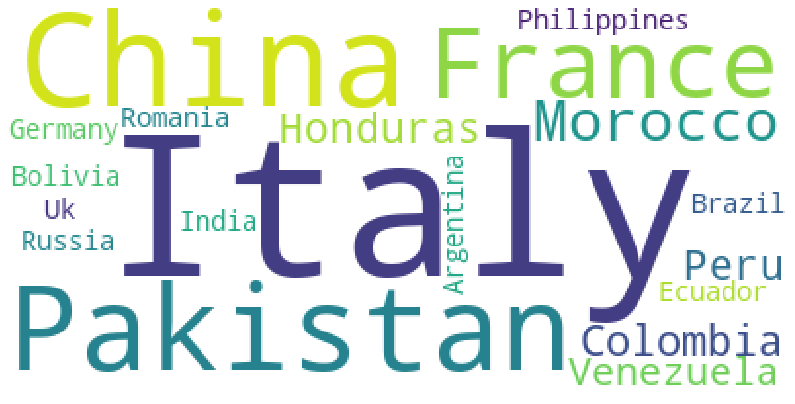

In [44]:
# calculate the total immigration
total_immigration = df_nat_cloud.iloc[0,0]-df_nat_cloud.iloc[1,0]

# Using countries with single-word names, let's duplicate each country's name based on % of the total immigration.
max_words = 50
word_string = ''
for country in df_nat_cloud.iloc[2:,:].index.values:
    repeat_num_times = int(df_nat_cloud.iloc[2:,:].loc[country, 0]/float(total_immigration)*max_words)
    word_string = word_string + ((str(country) + ' ') * repeat_num_times)
                                     
# display the generated text
word_string

# create the word cloud
wordcloud = WordCloud(background_color='white').generate(word_string)

# display the cloud
fig = plt.figure()
fig.set_figwidth(14)
fig.set_figheight(18)

plt.imshow(wordcloud)
plt.axis('off')
plt.show()

### 4. Clustering
Clustering by % of immigrant population.

In [45]:
# split the data range into 10 bins
df_BCN['Immigration_ID'], imm_bins = pd.cut(np.asarray(df_BCN['Immigration_%']),10,labels=np.arange(1,11), retbins=True)
df_bins['Immigration_%'] = imm_bins[:10].round(2)
df_BCN.head()


,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4


### 5. Visual representation


In [46]:
bcn_immigration_map = choropleth_map(bcn_geo,'Immigration_ID',latitude,longitude)
bcn_immigration_map

In [47]:
df_bins[['Bin_ID','Immigration_%']]

,Bin_ID,Immigration_%
0,1,5.95
1,2,10.90
2,3,15.80
3,4,20.70
4,5,25.60
5,6,30.50
6,7,35.40
7,8,40.30
8,9,45.20
9,10,50.10


## Political scope<a name="politics"></a>

This scope will analyze the local elections voting in each neighborhood.


### 1. Data obtention. 

In [48]:
web_politics = 'https://www.bcn.cat/estadistica/castella/dades/barris/telec/loc/a2019.htm'

df_politics = web_to_dataframe(web_politics)

df_politics.head()

C:\Users\Ian\anaconda3\lib\site-packages\urllib3\connectionpool.py:1004: InsecureRequestWarning: Unverified HTTPS request is being made to host 'www.bcn.cat'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,


,Dto. Barrios,Electores,Votantes,Abstención,Nulos,Validos,Blancos,ERC-AM,BEC-ECG,PSC-CP,...,CNV,PCPC,P.D.S.J.E.,PFiV,PUM+J,P-LIB,FE JONS,dCIDE,N P R S,Partido más votado
0,BARCELONA,1.142.444,756.007,386.437,2.012,753.995,2.625,160.990,156.157,138.748,...,383,371,317,215,194,146,131,93,57,ERC-AM
1,,,,,,,,,,,...,,,,,,,,,,
2,1 1. el Raval,20.314,9.889,10.425,25,9.864,40,1.803,2.767,2.043,...,2,8,4,5,6,2,6,4,2,BEC-ECG
3,1 2. el Barri Gòtic,7.961,4.348,3.613,10,4.338,13,872,1.246,681,...,0,6,1,0,2,0,2,0,3,BEC-ECG
4,1 3. la Barceloneta,8.608,4.679,3.929,17,4.662,10,1.406,982,863,...,0,7,3,0,2,2,0,0,0,ERC-AM


### 2. Data processing

In [49]:
df_politics.drop(df_politics.columns[-1], axis=1, inplace=True)
df_pol_clean = process_data(df_politics)

# the votes of PACMA where presented in a different format so had to cast it to float and then to int 
df_pol_clean["PACMA"] = df_pol_clean["PACMA"].astype(float).astype(int)

df_pol_clean.head()

C:\Users\Ian\anaconda3\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,District,Neighborhood_ID,Neighborhood_name,Electores,Votantes,Abstención,Nulos,Validos,Blancos,ERC-AM,...,EB,CNV,PCPC,P.D.S.J.E.,PFiV,PUM+J,P-LIB,FE JONS,dCIDE,N P R S
0,1,1,el Raval,20314,9889,10425,25,9864,40,1803,...,6,2,8,4,5,6,2,6,4,2
1,1,2,el Barri Gòtic,7961,4348,3613,10,4338,13,872,...,3,0,6,1,0,2,0,2,0,3
2,1,3,la Barceloneta,8608,4679,3929,17,4662,10,1406,...,1,0,7,3,0,2,2,0,0,0
3,1,4,Sant Pere. Santa Caterina i la Ribera,12041,6945,5096,23,6922,23,1259,...,5,2,5,2,1,0,2,1,1,1
4,2,5,el Fort Pienc,21810,15285,6525,22,15263,49,3510,...,9,10,5,9,6,6,1,3,2,2


### 3. Data analysis
We can extract two different segmentations. First of all cluster by participation on the elections, and second by votes to the right and left political parties. First let's check the participation %.

In [50]:
# calculate the percentage of participation in each neighborhood and add them to the general dataframe
df_BCN['Political_Participation_%'] = round(df_pol_clean['Votantes'].div(np.asarray(df_pol_clean["Electores"]))*100,2)
df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08


In [51]:
max_vot_perc= float(df_BCN['Political_Participation_%'].max())
max_vot_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Political_Participation_%'].idxmax(axis = 0)])

min_vot_perc= float(df_BCN['Political_Participation_%'].min())
min_vot_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Political_Participation_%'].idxmin(axis = 0)])

print("The neighborhood with more participation on the locals elections is{} where the {:.2f}% of the population voted. ".format(max_vot_hood, max_vot_perc))
print("The neighborhood with less participation on the locals elections is{} where the {:.2f}% of the population voted. ".format(min_vot_hood, min_vot_perc))

The neighborhood with more participation on the locals elections is la Vila Olímpica del Poblenou where the 77.21% of the population voted. 
The neighborhood with less participation on the locals elections is la Marina del Prat Vermell - Zona Franca where the 40.15% of the population voted. 


Now we will analyze the votes grouping by left and right political parties. After some research, the political parties on this elections will be considered as:
* left = \[ERC-AM, BEC-ECG, PSC-CP, CUP-AMUNT, EVE, PACT, UNIDOS SI, PCPC, PUM+J, P-LIB, dCIDE \]
* right = \[BCN Cs, JUNTS, PP, BCAP, VOX, FC's, CNV , PFiV, FE JONS\]
* non-classifiable = \[PACMA, EB, P.D.S.J.E, N P R S\]

The left parties will be pondered as -1, the right +1 and the unknown as 0. Each vote will be multiplied by this ponderation, added up and the averge indicator obtained by diving by the number of voters.

In [52]:
left = ['ERC-AM', 'BEC-ECG', 'PSC-CP', 'CUP-AMUNT', 'EVE', 'PACT', 'UNIDOS SI', 'PCPC', 'PUM+J', 'P-LIB', 'dCIDE']
right = ['BCN Cs', 'JUNTS', 'PP', 'BCAP', 'VOX', 'FC\'s', 'CNV' , 'PFiV', 'FE JONS']
unknown = ['PACMA', 'EB', 'P.D.S.J.E', 'N P R S']

# rename columns basing on the mentioned criteria
df_pol_wing = df_pol_clean.iloc[:,9:].rename(columns=lambda x: 'Left' if x in left else ('Right' if x in right else 'Unknown'))
df_pol_wing.head()

,Left,Left,Left,Right,Right,Right,Unknown,Right,Right,Unknown,...,Unknown,Right,Left,Unknown,Right,Left,Left,Right,Left,Unknown
0,1803,2767,2043,1155,660,387,402,238,111,112,...,6,2,8,4,5,6,2,6,4,2
1,872,1246,681,475,345,135,256,174,51,38,...,3,0,6,1,0,2,0,2,0,3
2,1406,982,863,423,363,166,184,110,51,56,...,1,0,7,3,0,2,2,0,0,0
3,1259,2101,1181,719,557,266,302,237,68,91,...,5,2,5,2,1,0,2,1,1,1
4,3510,3217,2483,1792,1773,678,693,671,172,103,...,9,10,5,9,6,6,1,3,2,2


In [53]:
# to group by left and right
df_pol_wing = df_pol_wing.transpose()
df_pol_wing = df_pol_wing.reset_index()
df_pol_wing = df_pol_wing.groupby("index").sum().transpose()
df_pol_wing.head()

index,Left,Right,Unknown
0,6669,2607,548
1,2836,1182,307
2,3283,1118,251
3,4586,1904,409
4,9271,5118,825


In [54]:
# ponderate as mentioned, in this case unknown is 0 so the added ponderation would be right - left
# then we divide by the number of voters and we get the indicator
df_pol_indicator = (df_pol_wing['Right']-df_pol_wing['Left'])/df_pol_clean['Validos']

df_BCN["Political_Bias"] = df_pol_indicator.round(2)
df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%,Political_Bias
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68,-0.41
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62,-0.38
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36,-0.46
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68,-0.39
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08,-0.27


In [55]:
right_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Political_Bias'].idxmax(axis = 0)])

left_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Political_Bias'].idxmin(axis = 0)])

print("The neighborhood with a bias closer to the right wing ideology is{}. ".format(right_hood))
print("The neighborhood with a bias closer to the left wing ideology is{}. ".format(left_hood))

The neighborhood with a bias closer to the right wing ideology is Pedralbes. 
The neighborhood with a bias closer to the left wing ideology is la Clota. 


### 4. Clustering
Clustering by % of participation and political bias.

In [56]:
# split the data range into 10 bins 
# by participation
df_BCN['Political_Participation_ID'], imm_bins = pd.cut(np.asarray(df_BCN['Political_Participation_%']),10,labels=np.arange(1,11), retbins=True)
df_bins['Political_Participation_%'] = imm_bins[:10].astype(int)

# by political bias
df_BCN['Political_Bias_ID'], imm_bins = pd.cut(np.asarray(df_BCN['Political_Bias']),10,labels=np.arange(1,11), retbins=True)
df_bins['Political_Bias'] = imm_bins[:10].round(2)

df_BCN.head()


,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%,Political_Bias,Political_Participation_ID,Political_Bias_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68,-0.41,3,2
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62,-0.38,4,2
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36,-0.46,4,2
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68,-0.39,5,2
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08,-0.27,9,4


### 5. Visual representation


In [57]:
# by participation
bcn_participation_map = choropleth_map(bcn_geo,'Political_Participation_ID',latitude,longitude)
bcn_participation_map

In [58]:
df_bins[['Bin_ID','Political_Participation_%']]

,Bin_ID,Political_Participation_%
0,1,40
1,2,43
2,3,47
3,4,51
4,5,54
5,6,58
6,7,62
7,8,66
8,9,69
9,10,73


In [59]:
# by political bias left is -1 and right is 1
bcn_political_map = choropleth_map(bcn_geo,'Political_Bias_ID',latitude,longitude)
bcn_political_map

In [60]:
df_bins[['Bin_ID','Political_Bias']]

,Bin_ID,Political_Bias
0,1,-0.57
1,2,-0.48
2,3,-0.38
3,4,-0.28
4,5,-0.19
5,6,-0.09
6,7,0.00
7,8,0.10
8,9,0.19
9,10,0.29


## Household income scope<a name="income"></a>

This scope will analyze the [Household income](https://en.wikipedia.org/wiki/Disposable_household_and_per_capita_income) in the distinct neighborhoods of the city. Note that the latest information dates back to 2017.

### 1. Data obtention. 

In [61]:
web_income = 'https://www.bcn.cat/estadistica/castella/dades/barris/economia/renda/rdfamiliar/a2017.htm'

df_income = web_to_dataframe(web_income)

df_income.head()

C:\Users\Ian\anaconda3\lib\site-packages\urllib3\connectionpool.py:1004: InsecureRequestWarning: Unverified HTTPS request is being made to host 'www.bcn.cat'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,


,Dto. Barrios,Población,Índice RFD Barcelona = 100
0,BARCELONA,1.625.137,"100,0"
1,,,
2,1 1. el Raval,47.986,"71,2"
3,1 2. el Barri Gòtic,16.240,"106,1"
4,1 3. la Barceloneta,15.101,"79,6"


### 2. Data processing

In [62]:
df_inc_clean = process_data(df_income)

df_inc_clean

C:\Users\Ian\anaconda3\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,District,Neighborhood_ID,Neighborhood_name,Población,Índice RFD Barcelona = 100
0,1,1,el Raval,47986,71.2
1,1,2,el Barri Gòtic,16240,106.1
2,1,3,la Barceloneta,15101,79.6
3,1,4,Sant Pere. Santa Caterina i la Ribera,22923,99.4
4,2,5,el Fort Pienc,32048,106.5
5,2,6,la Sagrada Família,51651,101.8
6,2,7,la Dreta de l'Eixample,44246,175.9
7,2,8,l'Antiga Esquerra de l'Eixample,42512,137.2
8,2,9,la Nova Esquerra de l'Eixample,58315,110.2
9,2,10,Sant Antoni,38412,104.2


### 3. Data analysis
The [RFD index](https://www.diba.cat/hg2/presentacio.asp?prId=888&idioma=cat&codi_any=2017&format=pantalla) (household index) for Barcelona on 2017 was 22390 €. In 2019 was 23.845 €. First we will convert from RFD to euros. 

In [63]:
rfd_100 = 22390

df_BCN["Household_income"]= df_inc_clean.iloc[:,4].astype(float)*rfd_100/100

df_BCN

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%,Political_Bias,Political_Participation_ID,Political_Bias_ID,Household_income
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68,-0.41,3,2,15941.68
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62,-0.38,4,2,23755.79
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36,-0.46,4,2,17822.44
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68,-0.39,5,2,22255.66
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08,-0.27,9,4,23845.35
5,2,6,la Sagrada Família,51385,3.14,9,45,7,10957,21.0,4,69.12,-0.29,8,3,22793.02
6,2,7,la Dreta de l'Eixample,43515,2.66,8,44,6,9992,23.0,4,71.55,-0.13,9,5,39384.01
7,2,8,l'Antiga Esquerra de l'Eixample,42393,2.59,8,44,6,9709,23.0,4,69.56,-0.15,8,5,30719.08
8,2,9,la Nova Esquerra de l'Eixample,58032,3.55,10,45,7,11178,19.0,3,70.01,-0.19,9,4,24673.78
9,2,10,Sant Antoni,38236,2.34,7,45,7,8732,23.0,4,68.11,-0.30,8,3,23330.38


In [64]:
max_inc = int(df_BCN['Household_income'].max())
max_inc_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Household_income'].idxmax(axis = 0)])

min_inc = int(df_BCN['Household_income'].min())
min_inc_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Household_income'].idxmin(axis = 0)])

print("The neighborhood with the higher available income is{} with an average of {:.2f} euros per habitant. ".format(max_inc_hood, max_inc))
print("The neighborhood with the lowest available income is{} with an average of {:.2f} euros per habitant. ".format(min_inc_hood, min_inc))

The neighborhood with the higher available income is Pedralbes with an average of 55706.00 euros per habitant. 
The neighborhood with the lowest available income is Ciutat Meridiana with an average of 8642.00 euros per habitant. 


Let's represent the boxplot of the available income per neighborhood, and the distribution of the richness. We will also take into consideration the [poverty threshold](https://www.idescat.cat/indicadors/?id=anuals&n=10411) for a single adult home, which is 10.096,5 € for 2017.

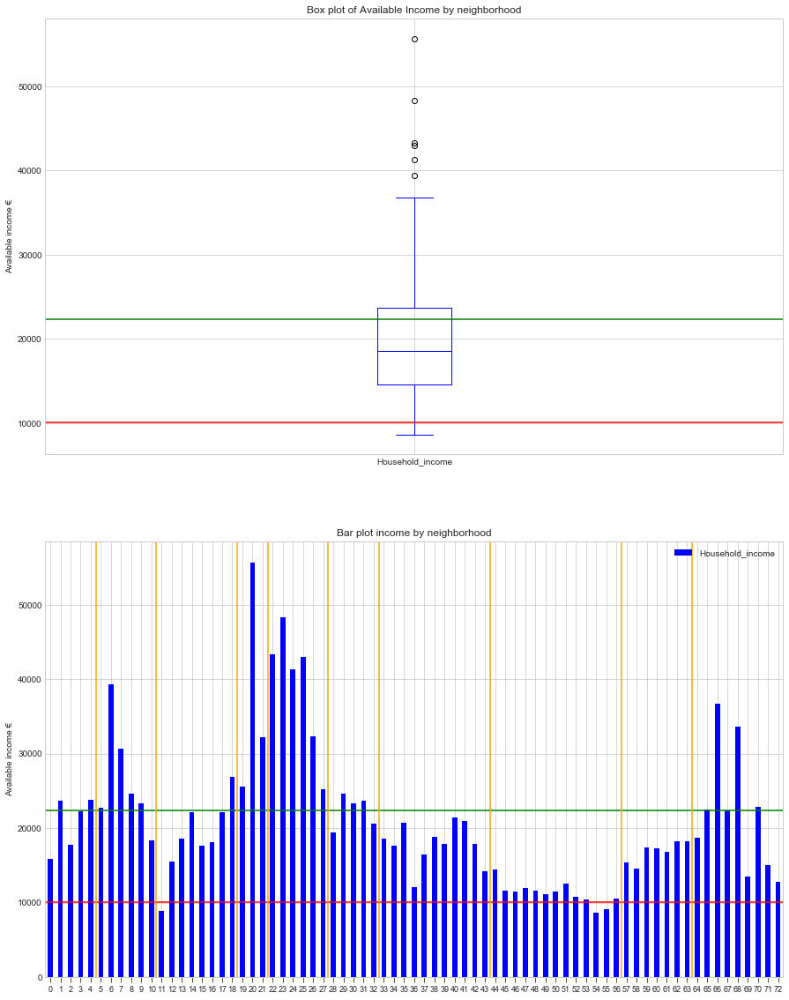

In [65]:
df_inc_box = df_BCN[['Neighborhood_name','Household_income']]

poverty_thld = 10096.5
fig = plt.figure() # create figure

ax0 = fig.add_subplot(2, 1, 1) # add subplot 1 (1 row, 2 columns, first plot)
ax1 = fig.add_subplot(2, 1, 2) # add subplot 2 (1 row, 2 columns, second plot). See tip below**

# Subplot 1: Box plot
df_inc_box.plot(kind='box', color='blue',figsize=(15, 20),widths=0.1,   ax=ax0) # add to subplot 1
ax0.set_title('Box plot of Available Income by neighborhood')
ax0.set_ylabel('Available income €')
ax0.axhline(y=rfd_100, color='g', linestyle='-')
ax0.axhline(y=poverty_thld, color='r', linestyle='-')

# Subplot 2: bar plot
df_inc_box.plot(kind='bar', color ='b', ax=ax1) # add to subplot 2
ax1.set_title ('Bar plot income by neighborhood')
ax1.set_ylabel('Available income €')
ax1.axhline(y=rfd_100, color='g', linestyle='-')
ax1.axhline(y=poverty_thld, color='r', linestyle='-')
for district_lim in [4.5, 10.5, 18.5, 21.5, 27.5, 32.5,43.5,56.5,63.5]:
    ax1.axvline(x=district_lim,color = 'orange', linestyle='-')
ax1.tick_params(axis="x", labelsize=9,labelrotation=0, length=6)

plt.show()

In [66]:
# we can see in the plots that most of the population is under the average of the city. Let's obtain some statistics
df_inc_box.describe().round(2)

,Household_income
count,73.00
mean,20972.99
std,9562.72
min,8642.54
25%,14575.89
50%,18561.31
75%,23666.23
max,55706.32


We can observe that one out of two neighborhoods is below the city indicator, one out of four is closer to the poverty threshold than to the city average, and only 25% of the city is above the average.

### 4. Clustering
Clustering by household income.

In [68]:
# split the data range into 10 bins using deciles
df_BCN['Household_income_ID'], imm_bins = pd.cut(np.asarray(df_BCN['Household_income']),10,labels=np.arange(1,11), retbins=True)
df_bins['Household_income'] = imm_bins[:10].astype(int)
df_BCN.head()


,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%,Political_Bias,Political_Participation_ID,Political_Bias_ID,Household_income,Household_income_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68,-0.41,3,2,15941.68,2
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62,-0.38,4,2,23755.79,4
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36,-0.46,4,2,17822.44,2
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68,-0.39,5,2,22255.66,3
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08,-0.27,9,4,23845.35,4


### 5. Visual representation


In [69]:
bcn_income_map = choropleth_map(bcn_geo,'Household_income_ID',latitude,longitude)
bcn_income_map

In [70]:
df_bins[['Bin_ID','Household_income']]

,Bin_ID,Household_income
0,1,8595
1,2,13348
2,3,18055
3,4,22761
4,5,27468
5,6,32174
6,7,36880
7,8,41587
8,9,46293
9,10,50999


## Unemployment scope<a name="unemployment"></a>

This scope will analyze the unemployment distribution in the city of Barcelona.


### 1. Data obtention. 
For this table we will use an alternative library to obtain the data, this time from an excel document. The excel is a copy of the [2019 monthly unemployment table](https://www.bcn.cat/estadistica/castella/dades/barris/ttreball/atur/evolucio/pesatbar.htm) provided by the Barcelona city council.

First of all we have to install the xlrd library for excel document manipulation, as pandas uses it to convert from xls to dataframe.

In [71]:
!conda install -c anaconda xlrd --yes

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\Ian\anaconda3

  added / updated specs:
    - xlrd


The following packages will be SUPERSEDED by a higher-priority channel:

  conda              conda-forge::conda-4.8.3-py37hc8dfbb8~ --> anaconda::conda-4.8.3-py37_0


Preparing transaction: ...working... done
Verifying transaction: ...working... done
Executing transaction: ...working... done


In [72]:
excel_path= 'https://github.com/IanRiera/Coursera_Capstone/blob/master/Final_Project/unemployment_2019.xlsx?raw=true'

# panda includes a function to read excel files
df_unemployment = pd.read_excel(excel_path)

df_unemployment.head()

,District,Neighborhood_ID,Neighborhood_name,Work-age_population,January,February,March,April,May,June,July,August,September,October,November,December
0,1,1,el Raval,36405,9.1,9.1,9.0,8.7,8.3,8.1,8.1,8.1,8.0,8.2,8.5,8.4
1,1,2,el Barri Gòtic,15462,5.8,5.6,5.6,5.5,5.5,5.3,5.3,5.2,5.6,5.7,5.7,5.8
2,1,3,la Barceloneta,11337,8.7,8.6,8.9,8.3,8.0,7.8,8.0,8.0,8.0,8.2,8.7,8.6
3,1,4,"Sant Pere, Santa Caterina i la Ribera",17710,7.7,7.6,7.8,7.4,7.1,6.9,7.1,7.1,7.1,7.3,7.7,7.6
4,2,5,el Fort Pienc,21844,5.5,5.4,5.5,5.4,5.3,5.1,5.2,5.3,5.3,5.4,5.4,5.3


### 2. Data processing
In this case we already have prepared the data properly in the excel sheet, so no further processing is required.

### 3. Data analysis
First we can calculate and add the anual average unemployed to the general table. 

In [73]:
df_BCN["Unemployed"] = (df_unemployment.iloc[:,4:].mean(axis=1)*df_unemployment['Work-age_population']).astype(int)
df_BCN["Unemployment_%"] = round(df_unemployment.iloc[:,4:].mean(axis=1),2)

df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%,Political_Bias,Political_Participation_ID,Political_Bias_ID,Household_income,Household_income_ID,Unemployed,Unemployment_%
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68,-0.41,3,2,15941.68,2,308229,8.47
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62,-0.38,4,2,23755.79,4,85814,5.55
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36,-0.46,4,2,17822.44,2,94286,8.32
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68,-0.39,5,2,22255.66,3,130463,7.37
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08,-0.27,9,4,23845.35,4,116683,5.34


In [74]:
max_unemployment = int(df_BCN['Unemployed'].max())
max_unemployment_perc = float(df_BCN['Unemployment_%'].max())
max_unemployment_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Unemployment_%'].idxmax(axis = 0)])

min_unemployment = int(df_BCN['Unemployed'].min())
min_unemployment_perc= float(df_BCN['Unemployment_%'].min())
min_unemployment_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Unemployment_%'].idxmin(axis = 0)])

print("The neighborhood with more unemployment in Barcelona is{} with the {:.2f}% of the population unemployed, {:d} potential workers. ".format(max_unemployment_hood, max_unemployment_perc, max_unemployment))
print("The neighborhood with less unemployment in Barcelona is{} with the {:.2f}% of the population unemployed, {:d} potential workers. ".format(min_unemployment_hood, min_unemployment_perc, min_unemployment))

The neighborhood with more unemployment in Barcelona is Ciutat Meridiana with the 12.55% of the population unemployed, 308229 potential workers. 
The neighborhood with less unemployment in Barcelona is Vallvidrera. el Tibidabo i les Planes with the 2.87% of the population unemployed, 1604 potential workers. 


Let's represent the boxplots by the month evolution of the unemployment.

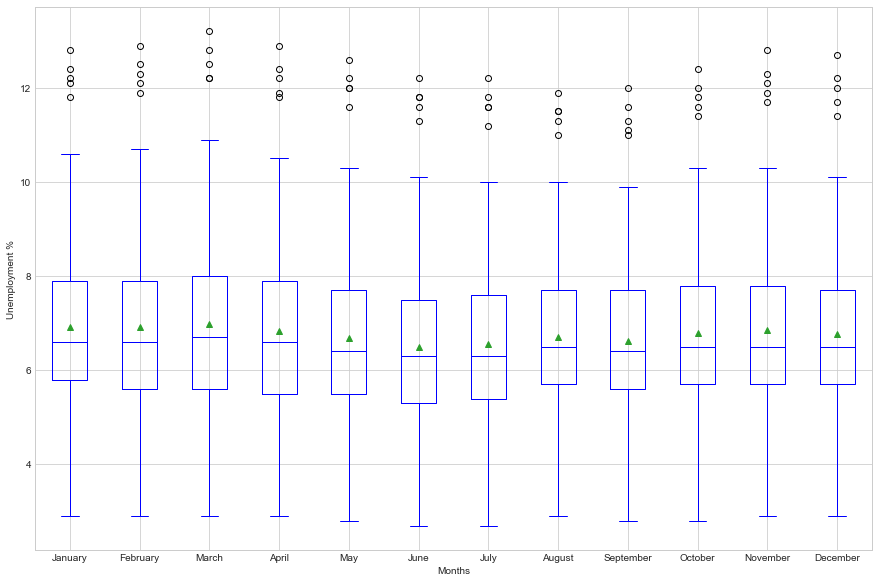

In [75]:
df_unem_line = df_unemployment.drop(columns=['District','Neighborhood_ID','Work-age_population'])
df_unem_line.plot(kind='box', figsize=(15, 10),meanline=False,color = 'b', autorange=True, showmeans=True)

plt.ylabel('Unemployment %')
plt.xlabel('Months')

plt.show()

In [76]:
df_unem_line.describe().round(2)

,January,February,March,April,May,June,July,August,September,October,November,December
count,73.00,73.00,73.00,73.00,73.00,73.00,73.00,73.00,73.00,73.00,73.00,73.00
mean,6.92,6.92,6.99,6.83,6.68,6.50,6.56,6.70,6.62,6.78,6.86,6.78
std,2.17,2.20,2.27,2.18,2.15,2.09,2.05,1.96,1.96,2.07,2.14,2.08
min,2.90,2.90,2.90,2.90,2.80,2.70,2.70,2.90,2.80,2.80,2.90,2.90
25%,5.80,5.60,5.60,5.50,5.50,5.30,5.40,5.70,5.60,5.70,5.70,5.70
50%,6.60,6.60,6.70,6.60,6.40,6.30,6.30,6.50,6.40,6.50,6.50,6.50
75%,7.90,7.90,8.00,7.90,7.70,7.50,7.60,7.70,7.70,7.80,7.80,7.70
max,12.80,12.90,13.20,12.90,12.60,12.20,12.20,11.90,12.00,12.40,12.80,12.70


We can observe that in general terms the unemployment behaves in the same way, decreasing during spring and summer which are the touristic high season, and increasing afterwards with a Christmas break. However, in August, while the maximum keeps decreasing, the min and mean values increase as many businesses close for holidays the whole month. We can see that in September recovers as new season begins.

### 4. Clustering


In [80]:
# split the data range into 10 bins
df_BCN['Unemployment_ID'], imm_bins = pd.cut(np.asarray(df_BCN['Unemployment_%']),10,labels=np.arange(1,11), retbins=True)
df_bins['Unemployment_%'] = imm_bins[:10].round(2)
df_BCN.head()


,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%,Political_Bias,Political_Participation_ID,Political_Bias_ID,Household_income,Household_income_ID,Unemployed,Unemployment_%,Unemployment_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68,-0.41,3,2,15941.68,2,308229,8.47,6
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62,-0.38,4,2,23755.79,4,85814,5.55,3
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36,-0.46,4,2,17822.44,2,94286,8.32,6
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68,-0.39,5,2,22255.66,3,130463,7.37,5
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08,-0.27,9,4,23845.35,4,116683,5.34,3


### 5. Visual representation

In [78]:
bcn_unem_map = choropleth_map(bcn_geo,'Unemployment_ID',latitude,longitude)
bcn_unem_map

In [81]:
df_bins[['Bin_ID','Unemployment_%']]

,Bin_ID,Unemployment_%
0,1,2.86
1,2,3.84
2,3,4.81
3,4,5.77
4,5,6.74
5,6,7.71
6,7,8.68
7,8,9.65
8,9,10.61
9,10,11.58


## Commercial venues scope<a name="commercial"></a>

This scope will analyze the commercial venues registered in the city by the public administration, and compare with the Foresquare output.


### 1. Data obtention. 
We will repeat the previous scenario and use xlr on a preprocessed excel table

In [82]:
web_commercial= 'https://github.com/IanRiera/Coursera_Capstone/blob/master/Final_Project/commercial_venues_2019.xlsx?raw=true'

# panda includes a function to read excel files
df_commercial = pd.read_excel(web_commercial)

df_commercial.head()

,District,Neighborhood_ID,Neighborhood_name,Supermarkets and consumables stores,Household items,Personal equipment stores,Culture and leisure stores,Car vendors,Real estate,Education services,Cultural and recreational services,Finantial and insurance services,Maintenance and cleaning,Home appliances and car repairing,"Restaurants, bars and hotels",Health assistance
0,1,1,el Raval,0.333137,0.049528,0.112618,0.078420,0.000590,0.005896,0.030660,0.036557,0.021226,0.000000,0.005307,0.317807,0.008255
1,1,2,el Barri Gòtic,0.132841,0.033948,0.327675,0.039852,0.000738,0.002214,0.012546,0.046494,0.022140,0.000000,0.000000,0.378598,0.002952
2,1,3,la Barceloneta,0.280093,0.018519,0.057870,0.039352,0.000000,0.023148,0.039352,0.020833,0.016204,0.000000,0.011574,0.460648,0.032407
3,1,4,"Sant Pere, Santa Caterina i la Ribera",0.228916,0.044750,0.244406,0.018933,0.000861,0.014630,0.033563,0.048193,0.014630,0.000000,0.001721,0.339071,0.010327
4,2,5,el Fort Pienc,0.263231,0.100279,0.080780,0.047354,0.025070,0.019499,0.040390,0.030641,0.022284,0.001393,0.045961,0.291086,0.032033


### 2. Data processing

The processing has been applied before hand on the excel table, calculating the frequency of every kind of store per neighborhood basing on the information provided on the city council webpage. 

### 3. Data analysis
Let's create a dataframe displaying the most frequent categories of venues for each neighborhood.

In [83]:
# function to sort the venues
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [84]:
df_commercial_aux =df_commercial.drop(columns=['District','Neighborhood_name'])

In [85]:
# Now let's create the new dataframe and display the top 10 venues for each neighborhood.
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood_ID']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
df_commercial_sorted = pd.DataFrame(columns=columns)
df_commercial_sorted['Neighborhood_ID'] = df_commercial_aux['Neighborhood_ID']

for ind in np.arange(df_commercial.shape[0]):
    df_commercial_sorted.iloc[ind, 1:] = return_most_common_venues(df_commercial_aux.iloc[ind, :], num_top_venues)

df_commercial_sorted.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,1,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Culture and leisure stores,Household items,Cultural and recreational services,Education services,Finantial and insurance services,Health assistance,Real estate
1,2,"Restaurants, bars and hotels",Personal equipment stores,Supermarkets and consumables stores,Cultural and recreational services,Culture and leisure stores,Household items,Finantial and insurance services,Education services,Health assistance,Real estate
2,3,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Education services,Culture and leisure stores,Health assistance,Real estate,Cultural and recreational services,Household items,Finantial and insurance services
3,4,"Restaurants, bars and hotels",Personal equipment stores,Supermarkets and consumables stores,Cultural and recreational services,Household items,Education services,Culture and leisure stores,Finantial and insurance services,Real estate,Health assistance
4,5,"Restaurants, bars and hotels",Supermarkets and consumables stores,Household items,Personal equipment stores,Culture and leisure stores,Home appliances and car repairing,Education services,Health assistance,Cultural and recreational services,Car vendors


In [86]:
# let's create a function to count the amount of times a category appears in a position of the top num
def create_ranking(df, num):
    tops = pd.DataFrame(df.iloc[:,1].value_counts())
                        
    for i in range(2,num +1):
        top = pd.DataFrame(df.iloc[:,i].value_counts())
        tops = tops.combine(top,np.maximum,fill_value=0)
    
    tops = (tops.assign(sum=tops.sum(axis=1)).sort_values(by='sum', ascending=False).iloc[:, :-1]/df.shape[0])*100  
    return tops

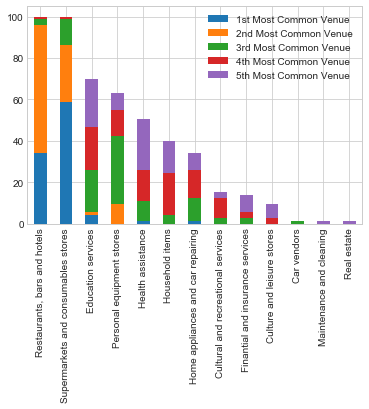

In [87]:
top_5 = create_ranking(df_commercial_sorted,5)
       
top_5.plot(kind='bar', stacked=True)

All the neighborhoods have restaurants category and supermarkets category in their top5. 

### 4. Clustering
For clustering by commercial venues, we will use k-means algorithm.

In [88]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

In [92]:
# set number of clusters
kclusters = 10

bcn_commercial_clustering = df_commercial_aux.drop('Neighborhood_ID', 1)

# run k-means clustering
kmeans = KMeans(init="random", n_clusters=kclusters, n_init=12).fit(bcn_commercial_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_

array([4, 6, 3, 6, 4, 4, 1, 1, 4, 4, 3, 0, 9, 9, 4, 9, 4, 4, 7, 4, 2, 9,
       7, 5, 7, 7, 7, 9, 8, 9, 7, 9, 4, 8, 9, 2, 8, 8, 9, 5, 5, 2, 9, 7,
       7, 8, 5, 9, 8, 8, 7, 4, 8, 5, 8, 8, 9, 5, 7, 7, 9, 4, 4, 4, 9, 1,
       3, 4, 6, 8, 4, 9, 9])

In [94]:
# Let's add the clustering labels to the general dataframe

df_BCN['Commercial_ID'] = pd.DataFrame(kmeans.labels_+1,columns=['Commercial_ID'])

df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,...,Political_Participation_%,Political_Bias,Political_Participation_ID,Political_Bias_ID,Household_income,Household_income_ID,Unemployed,Unemployment_%,Unemployment_ID,Commercial_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,...,48.68,-0.41,3,2,15941.68,2,308229,8.47,6,5
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,...,54.62,-0.38,4,2,23755.79,4,85814,5.55,3,7
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,...,54.36,-0.46,4,2,17822.44,2,94286,8.32,6,4
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,...,57.68,-0.39,5,2,22255.66,3,130463,7.37,5,7
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,...,70.08,-0.27,9,4,23845.35,4,116683,5.34,3,5


We will need to examine the clusters, so we can determine the discriminating venue categories that distinguish each cluster.


#### Cluster 1

In [95]:
df_comm_clust_1 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 1,:]
df_comm_clust_1


,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
11,12,Home appliances and car repairing,"Restaurants, bars and hotels",Car vendors,Supermarkets and consumables stores,Maintenance and cleaning,Education services,Culture and leisure stores,Household items,Finantial and insurance services,Health assistance


#### Cluster 2

In [273]:
df_comm_clust_2 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 2,:]
df_comm_clust_2.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
22,23,Supermarkets and consumables stores,Personal equipment stores,"Restaurants, bars and hotels",Education services,Health assistance,Household items,Real estate,Cultural and recreational services,Home appliances and car repairing,Culture and leisure stores
23,24,Health assistance,Supermarkets and consumables stores,"Restaurants, bars and hotels",Education services,Finantial and insurance services,Real estate,Household items,Culture and leisure stores,Personal equipment stores,Maintenance and cleaning
24,25,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Health assistance,Education services,Household items,Finantial and insurance services,Culture and leisure stores,Real estate,Home appliances and car repairing
26,27,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Health assistance,Education services,Household items,Real estate,Culture and leisure stores,Home appliances and car repairing,Finantial and insurance services
27,28,Supermarkets and consumables stores,"Restaurants, bars and hotels",Education services,Health assistance,Home appliances and car repairing,Household items,Personal equipment stores,Cultural and recreational services,Finantial and insurance services,Car vendors


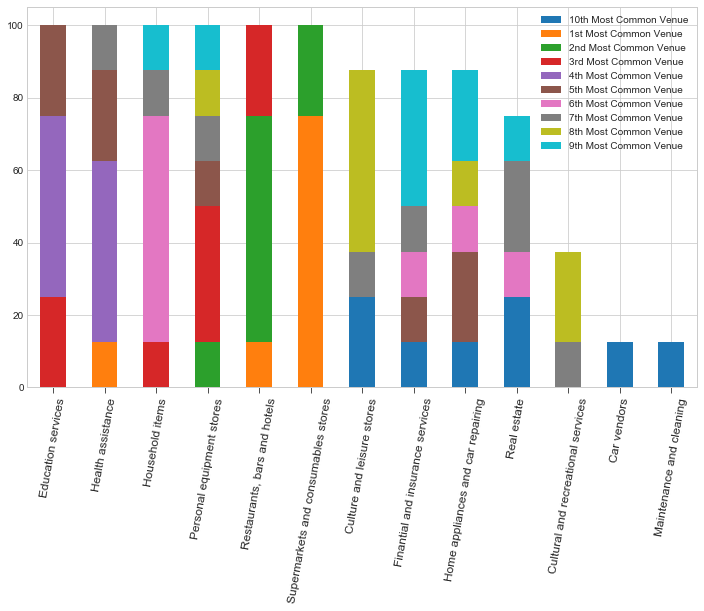

In [318]:
# let's use the function created previously to visually find the present categories
ranking_clust_2 = create_ranking(df_comm_clust_2,10)

ranking_clust_2.plot(kind='bar', stacked=True, figsize=(12, 7))
plt.tick_params(axis="x", labelsize=12,labelrotation=80, length=6)

#### Cluster 3

In [293]:
df_comm_clust_3 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 3,:]
df_comm_clust_3.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
28,29,Supermarkets and consumables stores,"Restaurants, bars and hotels",Finantial and insurance services,Health assistance,Personal equipment stores,Household items,Home appliances and car repairing,Cultural and recreational services,Education services,Real estate
29,30,Supermarkets and consumables stores,"Restaurants, bars and hotels",Health assistance,Personal equipment stores,Education services,Home appliances and car repairing,Household items,Finantial and insurance services,Cultural and recreational services,Culture and leisure stores
31,32,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Household items,Home appliances and car repairing,Health assistance,Culture and leisure stores,Education services,Finantial and insurance services,Real estate
34,35,Supermarkets and consumables stores,"Restaurants, bars and hotels",Home appliances and car repairing,Personal equipment stores,Household items,Education services,Health assistance,Finantial and insurance services,Real estate,Culture and leisure stores
36,37,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Household items,Education services,Home appliances and car repairing,Real estate,Health assistance,Culture and leisure stores,Finantial and insurance services


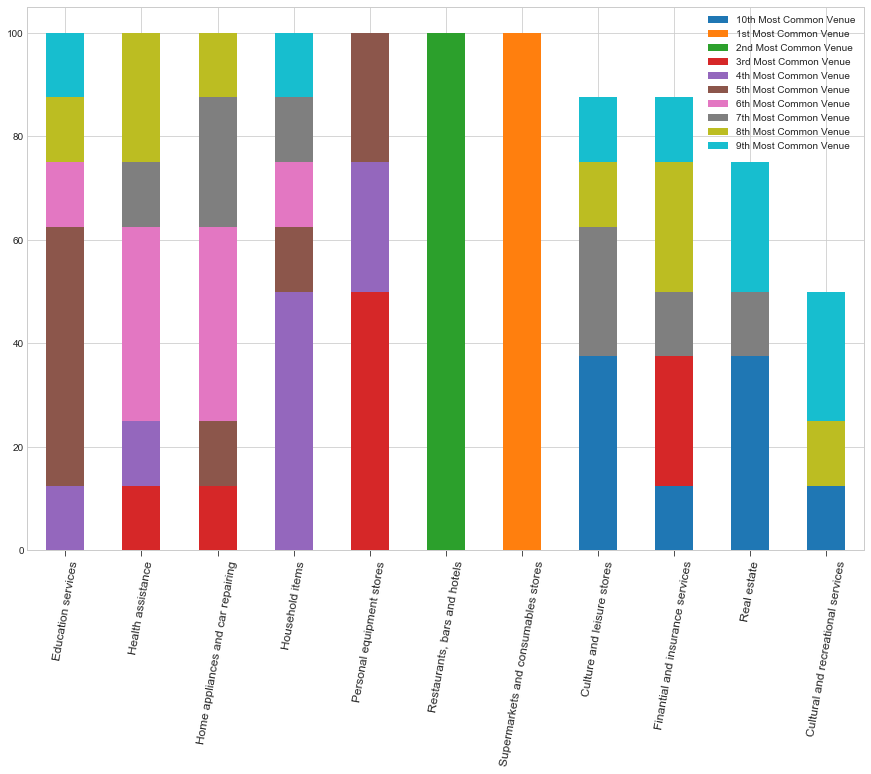

In [317]:
# let's use the function created previously to visually find the present categories
ranking_clust_3 = create_ranking(df_comm_clust_3,10)

ranking_clust_3.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=12,labelrotation=80, length=6)

#### Cluster 4

In [296]:
df_comm_clust_4 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 4,:]
df_comm_clust_4.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,3,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Education services,Culture and leisure stores,Health assistance,Real estate,Cultural and recreational services,Household items,Finantial and insurance services
10,11,"Restaurants, bars and hotels",Supermarkets and consumables stores,Cultural and recreational services,Home appliances and car repairing,Education services,Household items,Health assistance,Finantial and insurance services,Culture and leisure stores,Personal equipment stores
66,67,"Restaurants, bars and hotels",Supermarkets and consumables stores,Education services,Finantial and insurance services,Real estate,Health assistance,Personal equipment stores,Home appliances and car repairing,Culture and leisure stores,Cultural and recreational services
70,71,"Restaurants, bars and hotels",Supermarkets and consumables stores,Education services,Home appliances and car repairing,Health assistance,Household items,Culture and leisure stores,Finantial and insurance services,Personal equipment stores,Real estate


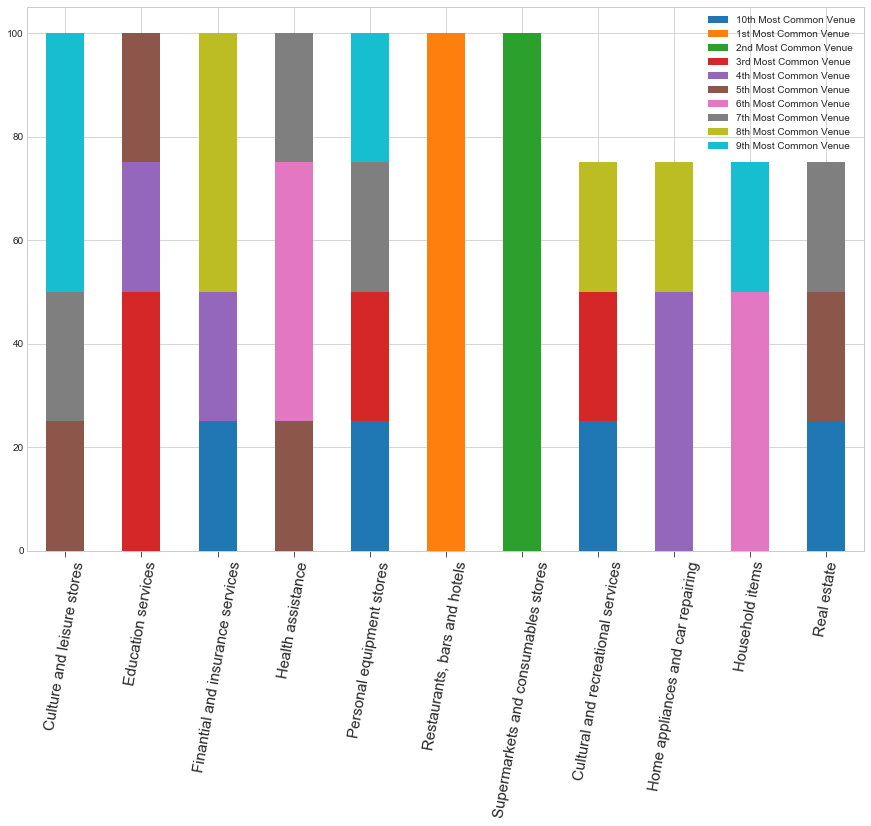

In [316]:
# let's use the function created previously to visually find the present categories
ranking_clust_4 = create_ranking(df_comm_clust_4,10)

ranking_clust_4.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 5

In [303]:
df_comm_clust_5 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 5,:]
df_comm_clust_5.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
9,10,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Culture and leisure stores,Household items,Health assistance,Education services,Real estate,Home appliances and car repairing,Finantial and insurance services
18,19,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Health assistance,Education services,Finantial and insurance services,Household items,Culture and leisure stores,Home appliances and car repairing,Real estate
25,26,"Restaurants, bars and hotels",Personal equipment stores,Supermarkets and consumables stores,Household items,Health assistance,Finantial and insurance services,Education services,Culture and leisure stores,Real estate,Home appliances and car repairing
30,31,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Household items,Education services,Health assistance,Culture and leisure stores,Cultural and recreational services,Home appliances and car repairing,Finantial and insurance services
58,59,"Restaurants, bars and hotels",Personal equipment stores,Supermarkets and consumables stores,Home appliances and car repairing,Household items,Car vendors,Culture and leisure stores,Finantial and insurance services,Education services,Maintenance and cleaning


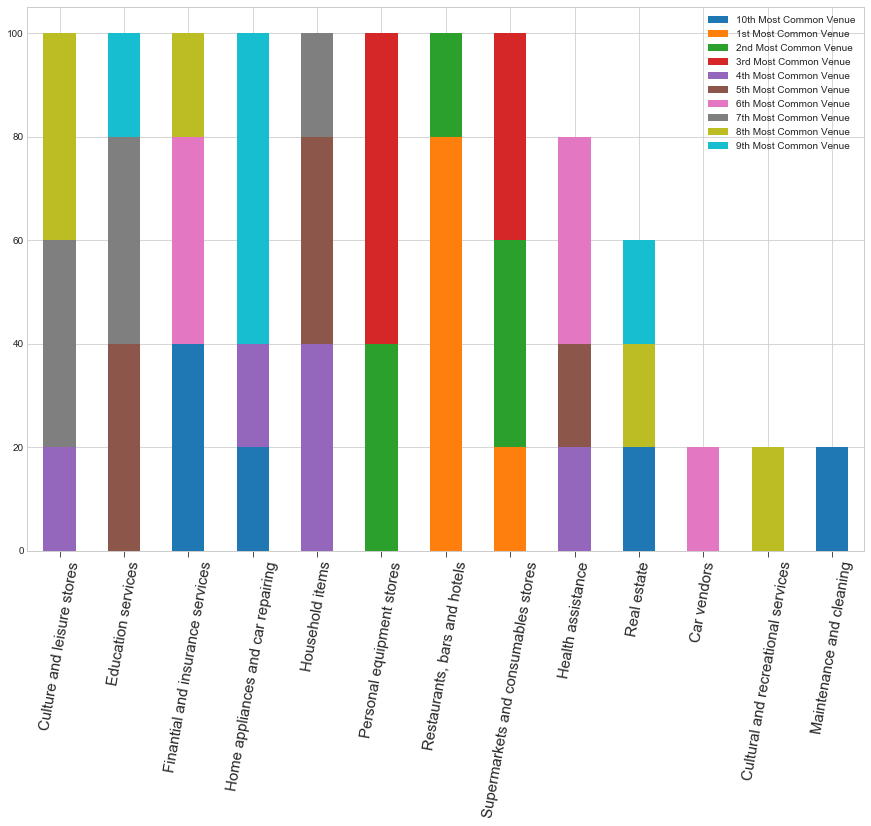

In [315]:
# let's use the function created previously to visually find the present categories
ranking_clust_5 = create_ranking(df_comm_clust_5,10)

ranking_clust_5.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 6

In [305]:
df_comm_clust_6 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 6,:]
df_comm_clust_6.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,1,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Culture and leisure stores,Household items,Cultural and recreational services,Education services,Finantial and insurance services,Health assistance,Real estate
4,5,"Restaurants, bars and hotels",Supermarkets and consumables stores,Household items,Personal equipment stores,Culture and leisure stores,Home appliances and car repairing,Education services,Health assistance,Cultural and recreational services,Car vendors
5,6,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Household items,Culture and leisure stores,Health assistance,Finantial and insurance services,Home appliances and car repairing,Education services,Real estate
8,9,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Household items,Health assistance,Home appliances and car repairing,Education services,Culture and leisure stores,Finantial and insurance services,Real estate
14,15,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Household items,Health assistance,Education services,Culture and leisure stores,Finantial and insurance services,Home appliances and car repairing,Real estate


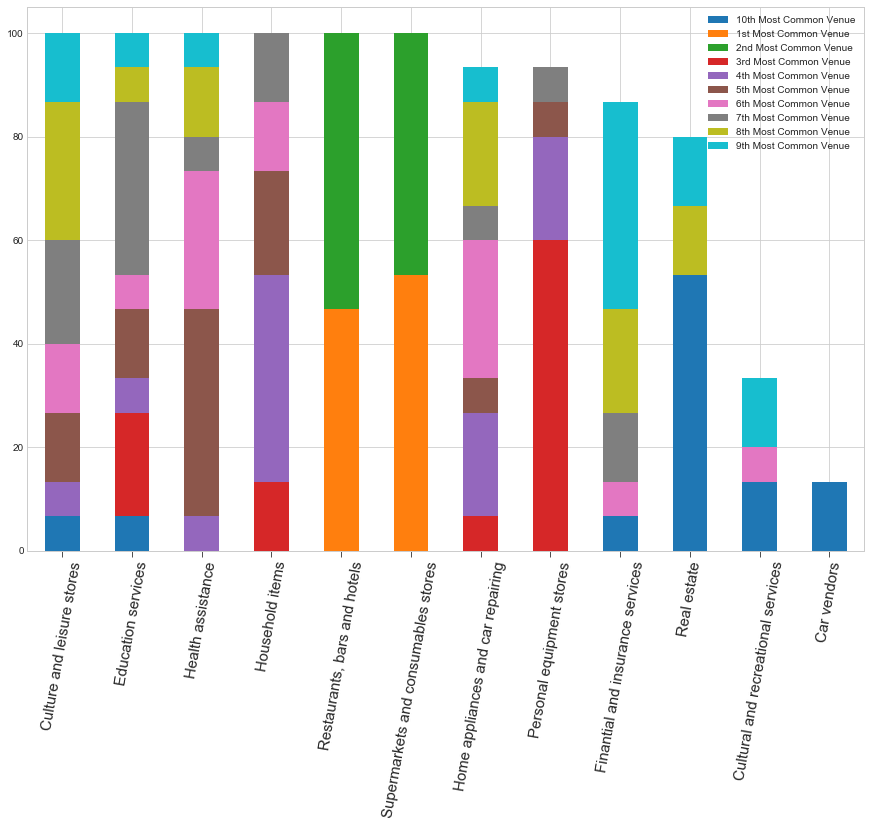

In [314]:
# let's use the function created previously to visually find the present categories
ranking_clust_6 = create_ranking(df_comm_clust_6,10)

ranking_clust_6.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 7

In [307]:
df_comm_clust_7 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 7,:]
df_comm_clust_7.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
12,13,Supermarkets and consumables stores,"Restaurants, bars and hotels",Health assistance,Personal equipment stores,Education services,Household items,Finantial and insurance services,Home appliances and car repairing,Cultural and recreational services,Culture and leisure stores
13,14,Supermarkets and consumables stores,"Restaurants, bars and hotels",Education services,Home appliances and car repairing,Health assistance,Household items,Cultural and recreational services,Culture and leisure stores,Maintenance and cleaning,Finantial and insurance services
15,16,Supermarkets and consumables stores,"Restaurants, bars and hotels",Education services,Home appliances and car repairing,Finantial and insurance services,Health assistance,Cultural and recreational services,Household items,Personal equipment stores,Real estate
21,22,Supermarkets and consumables stores,"Restaurants, bars and hotels",Cultural and recreational services,Health assistance,Finantial and insurance services,Education services,Real estate,Household items,Home appliances and car repairing,Maintenance and cleaning
47,48,Supermarkets and consumables stores,"Restaurants, bars and hotels",Health assistance,Education services,Personal equipment stores,Home appliances and car repairing,Finantial and insurance services,Culture and leisure stores,Household items,Cultural and recreational services


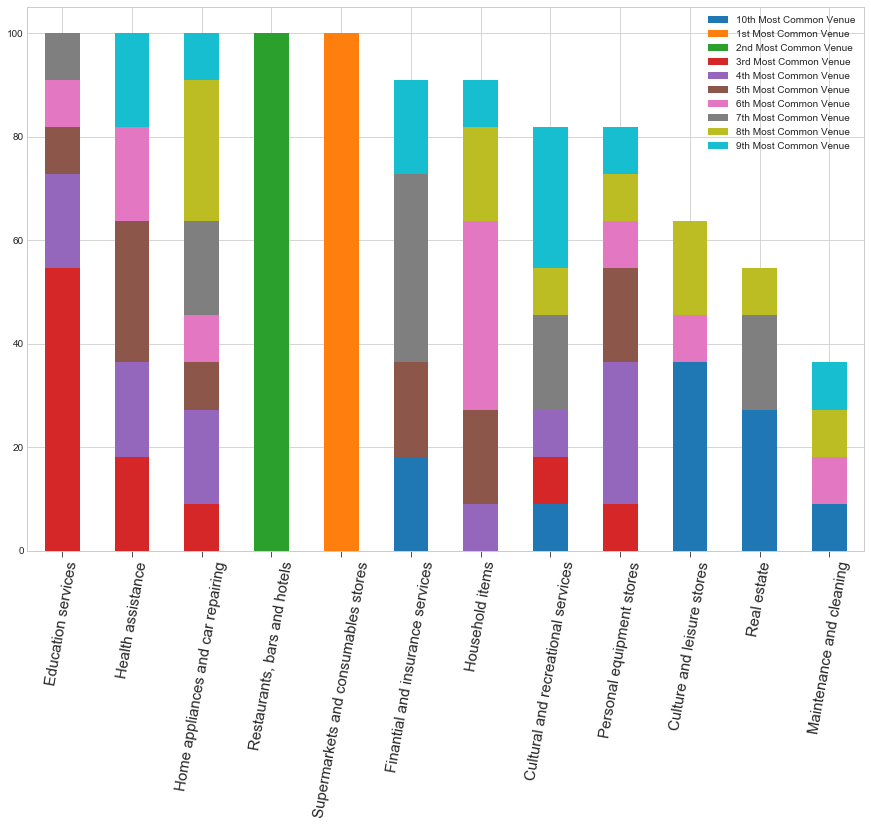

In [313]:
# let's use the function created previously to visually find the present categories
ranking_clust_7 = create_ranking(df_comm_clust_7,10)

ranking_clust_7.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 8

In [309]:
df_comm_clust_8 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 8,:]
df_comm_clust_8.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
20,21,Education services,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Finantial and insurance services,Health assistance,Culture and leisure stores,Household items,Cultural and recreational services,Real estate
35,36,Education services,"Restaurants, bars and hotels",Supermarkets and consumables stores,Home appliances and car repairing,Household items,Health assistance,Real estate,Cultural and recreational services,Finantial and insurance services,Car vendors
39,40,Supermarkets and consumables stores,"Restaurants, bars and hotels",Health assistance,Education services,Finantial and insurance services,Cultural and recreational services,Real estate,Home appliances and car repairing,Maintenance and cleaning,Culture and leisure stores
40,41,"Restaurants, bars and hotels",Supermarkets and consumables stores,Education services,Cultural and recreational services,Health assistance,Home appliances and car repairing,Finantial and insurance services,Real estate,Household items,Maintenance and cleaning
41,42,"Restaurants, bars and hotels",Education services,Supermarkets and consumables stores,Health assistance,Home appliances and car repairing,Maintenance and cleaning,Finantial and insurance services,Cultural and recreational services,Real estate,Car vendors


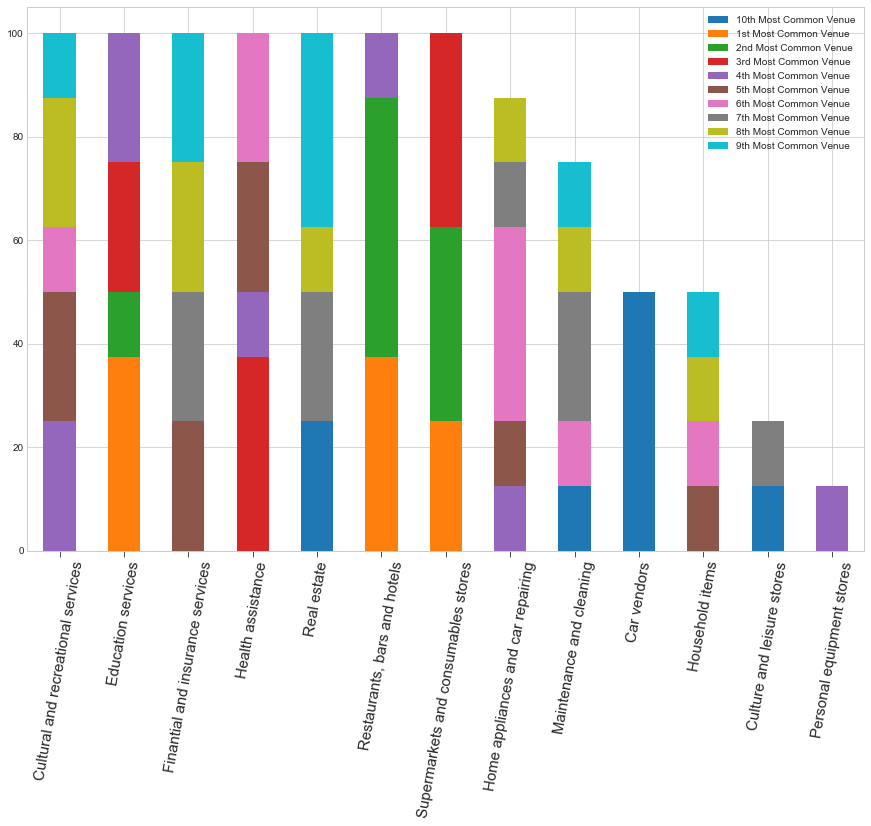

In [312]:
# let's use the function created previously to visually find the present categories
ranking_clust_8 = create_ranking(df_comm_clust_8,10)

ranking_clust_8.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 9

In [319]:
df_comm_clust_9 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 9,:]
df_comm_clust_9.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,2,"Restaurants, bars and hotels",Personal equipment stores,Supermarkets and consumables stores,Cultural and recreational services,Culture and leisure stores,Household items,Finantial and insurance services,Education services,Health assistance,Real estate
3,4,"Restaurants, bars and hotels",Personal equipment stores,Supermarkets and consumables stores,Cultural and recreational services,Household items,Education services,Culture and leisure stores,Finantial and insurance services,Real estate,Health assistance
6,7,"Restaurants, bars and hotels",Personal equipment stores,Supermarkets and consumables stores,Household items,Culture and leisure stores,Finantial and insurance services,Health assistance,Education services,Cultural and recreational services,Real estate
7,8,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Household items,Health assistance,Culture and leisure stores,Cultural and recreational services,Finantial and insurance services,Real estate,Home appliances and car repairing
65,66,"Restaurants, bars and hotels",Supermarkets and consumables stores,Personal equipment stores,Home appliances and car repairing,Education services,Household items,Cultural and recreational services,Culture and leisure stores,Car vendors,Health assistance


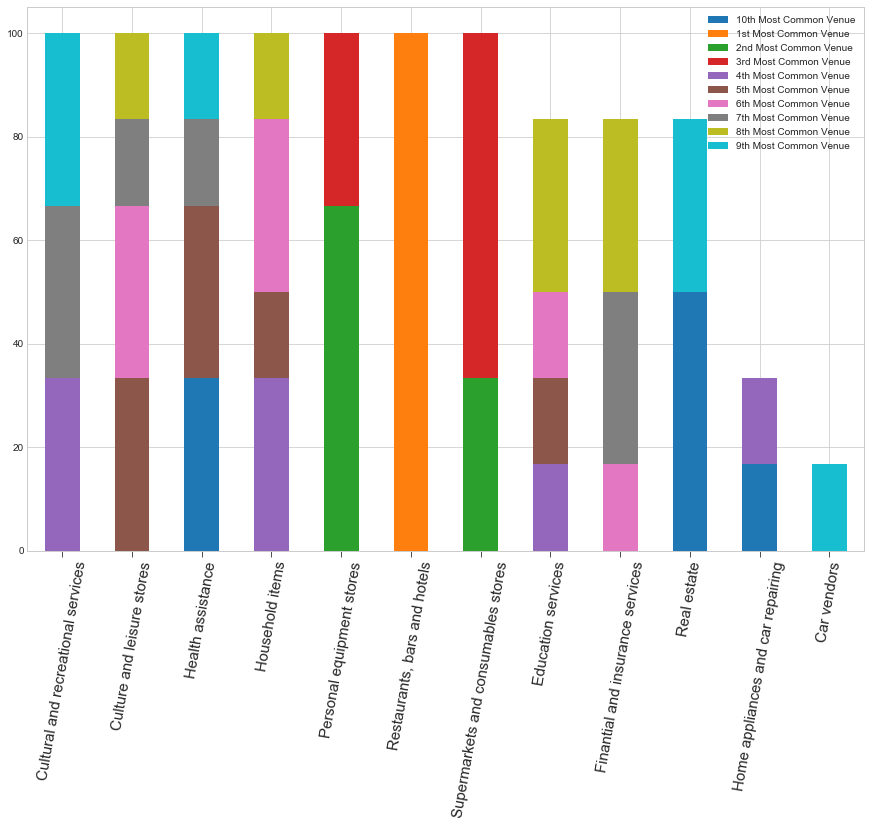

In [321]:
# let's use the function created previously to visually find the present categories
ranking_clust_9 = create_ranking(df_comm_clust_9,10)

ranking_clust_9.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 10

In [322]:
df_comm_clust_10 = df_commercial_sorted.loc[df_BCN['Commercial_ID'] == 10,:]
df_comm_clust_10.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
33,34,Supermarkets and consumables stores,"Restaurants, bars and hotels",Home appliances and car repairing,Education services,Health assistance,Cultural and recreational services,Culture and leisure stores,Personal equipment stores,Household items,Finantial and insurance services
37,38,Supermarkets and consumables stores,"Restaurants, bars and hotels",Home appliances and car repairing,Education services,Household items,Health assistance,Cultural and recreational services,Car vendors,Finantial and insurance services,Real estate
45,46,Supermarkets and consumables stores,"Restaurants, bars and hotels",Personal equipment stores,Health assistance,Education services,Household items,Real estate,Home appliances and car repairing,Culture and leisure stores,Finantial and insurance services
48,49,Supermarkets and consumables stores,"Restaurants, bars and hotels",Home appliances and car repairing,Education services,Finantial and insurance services,Cultural and recreational services,Personal equipment stores,Health assistance,Maintenance and cleaning,Real estate
49,50,Supermarkets and consumables stores,"Restaurants, bars and hotels",Home appliances and car repairing,Finantial and insurance services,Education services,Personal equipment stores,Household items,Cultural and recreational services,Health assistance,Real estate


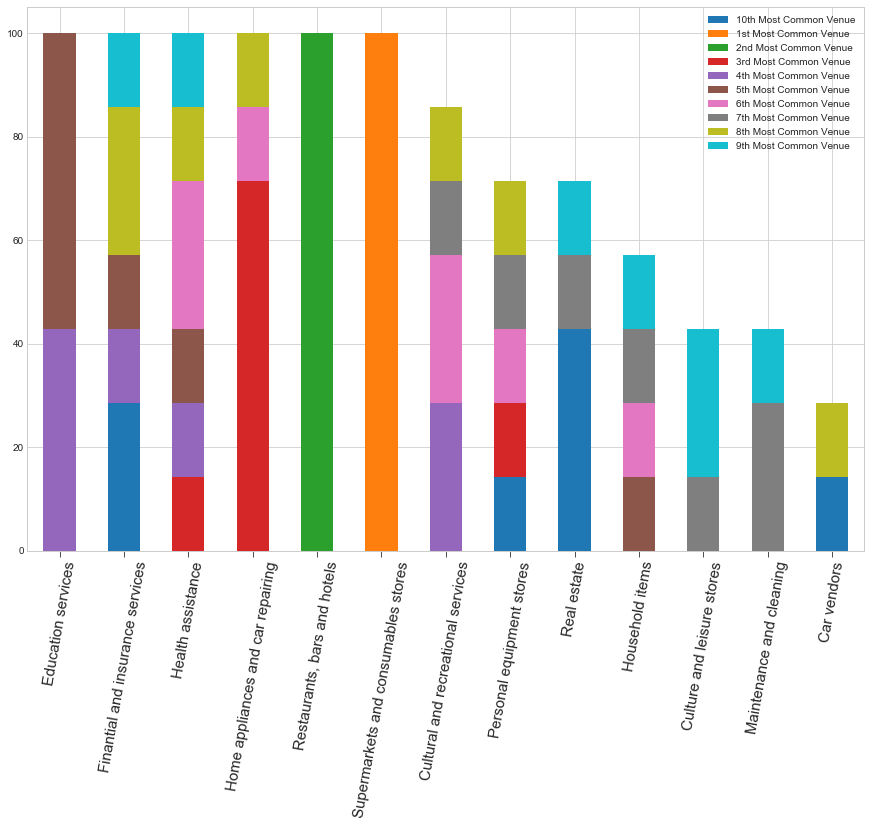

In [323]:
# let's use the function created previously to visually find the present categories
ranking_clust_10 = create_ranking(df_comm_clust_10,10)

ranking_clust_10.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

We will classify the clusters in a tree manner, so that **all the neighborhoods in the cluster** satisfy that in their top 10 of most frequent commercial venue categories:

* A: Top 1 is 'Restaurants, bars and hotels':
 - A.1: Top 2 is 'Supermarkets and consumable stores':
   * Cluster 4: 'Education services' between top 3 and top 5. 'Health assistance' between top 5 and top 7. All contain 'Culture and leisure stores' from top 5, 'Personal equipment stores' from top 7 and 'Finantial and insurance services' from top 8.
   * Cluster 10: 'Home appliances and car repairing' from and mainly as top 3, 'Education services' between top 4 and 5, and all contain 'Finantial and insurance services' and 'Health assistance' in the top 10.
 - A.2: Top 2 and top 3 contain 'Supermarkets and consumable stores' and 'Personal equipment stores':
   * Cluster 5: 'Household items' between top 4 and top 5. 'Culture and leisure stores' between top 7 and top 8. All contain 'Education services' from top 5, 'Finantial and insurance services' from top 6 and 'Home appliances and car repairing' from top 9.
   * Cluster 9: **Contains 'Cultural and recreational services'** in their top 10. Also all contain,'Household items', 'Health assistance' and 'Culture and leisure stores' from top 4.
* B: Top 1 is 'Supermarkets and consumable stores' and top 2 is 'Restaurants, bars and hotels':
 - Cluster 2: 'Personal equipment stores' is top 3 and 'Education services' between top 3 and top 5. 'Health assistance' between top 4 and top 5, and 'Household items' from top 6.
 - Cluster 3: 'Personal equipment stores' between top 3 and 5. 'Household items' between top 4 and 7. 'Health assistance' and 'Home appliances and car repairing' between top 6 and 8.'Education services' from the top 5.
 - Cluster 7: 'Education services' between top 3 and 4. 'Health assistance' between top 3 and top 6.'Home appliances and car repairing' between top 4 and 8.
* Cluster 1: This cluster has just one neighborhood, which has 'Home appliances and car repairing' as top 1, hotels as top 2 and car vendor as top 3. Two of the top3 are automobile related, so this cluster can be defined by that.
* Cluster 6: The top 1 and 2 are shared by 'Restaurants, bars and hotels' and 'Supermarkets and consumable stores'. 'Health assistance' between top 5 and top 6. 'Household items' between top 4 and 7, 'Culture and leisure stores' from top 4, and 'Education services' between top 3 and top 9, mainly in top 7.
* Cluster 8: **Contains 'Real estate'** in their top 10. The top 1, 2 and 3 are shared by 'Restaurants, bars and hotels', 'Supermarkets and consumable stores' and 'Personal equipment stores'. Als contains 'Health assistance' between top 3 and top 6, and 'Finantial and insurance services' between top 5 and top 9.

### 5. Visual representation
The choropleth map is created, being yellow the youngest and red the eldest.

In [251]:
bcn_commercial_map = choropleth_map(bcn_geo,'Commercial_ID',latitude,longitude)
bcn_commercial_map

### Foursquare scope<a name="foresquare"></a>



### 1. Data obtention
Now let's use Foursquare API to get the venues in each neighborhood.
Obtain credentials as:

CLIENT_ID = '' # your Foursquare ID

CLIENT_SECRET = '' # your Foursquare Secret

VERSION = '20180605' # Foursquare API version

In [97]:
# function to get the nearby venues
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood_ID', 
                  'Neighborhood_latitude', 
                  'Neighborhood_longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [98]:
# we need to retrieve the latitudes and logitudes of our neighborhoods
df_coordinates = pd.read_excel('https://github.com/IanRiera/Coursera_Capstone/blob/master/Final_Project/BCN_lat_long.xlsx?raw=true')
df_coordinates.head()

,District,Neighborhood_ID,Neighborhood_name,Latitude,Longitude
0,1,1,el Raval,41.380000,2.168600
1,1,2,el Barri Gòtic,41.382778,2.176944
2,1,3,la Barceloneta,41.379400,2.189200
3,1,4,"Sant Pere, Santa Caterina i la Ribera",41.385000,2.183000
4,2,5,el Fort Pienc,41.395670,2.183700


In [99]:
# we run it for our list of neighborhoods
LIMIT = 50 # limit of number of venues returned by Foresquare
radius = 700 # define radius

barcelona_venues = getNearbyVenues(names=df_coordinates['Neighborhood_ID'],
                                   latitudes=df_coordinates['Latitude'],
                                   longitudes=df_coordinates['Longitude']
                                  )
barcelona_venues.head()

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73


,Neighborhood_ID,Neighborhood_latitude,Neighborhood_longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,1,41.38,2.1686,A Tu Bola,41.380096,2.169054,Tapas Restaurant
1,1,41.38,2.1686,La Robadora,41.379500,2.170463,Gastropub
2,1,41.38,2.1686,33/45,41.381059,2.167399,Cocktail Bar
3,1,41.38,2.1686,Sabores de Portugal,41.380167,2.166956,Portuguese Restaurant
4,1,41.38,2.1686,Robadors 23,41.379581,2.170603,Jazz Club


### 2. Data processing

In [100]:
print('There are {} uniques categories.'.format(len(barcelona_venues['Venue Category'].unique())))

There are 247 uniques categories.


Compared to the information obtained from the city council, Foresquare provides a wider amount of different categories. Therefore, we should try to group them by Restaurants, shops, etc.

In [101]:
def group_categories(group_words,new_name, df, column):
    for word in group_words:
        df.loc[df[column].str.contains(word, case=False), column] = new_name
        print(word)
    return df

In [102]:
barcelona_venues_clean = barcelona_venues.copy()

In [103]:
df_commercial.columns

Index(['District', 'Neighborhood_ID', 'Neighborhood_name',
       'Supermarkets and consumables stores', 'Household items',
       'Personal equipment stores', 'Culture and leisure stores',
       'Car vendors', 'Real estate', 'Education services',
       'Cultural and recreational services',
       'Finantial and insurance services', 'Maintenance and cleaning',
       'Home appliances and car repairing', 'Restaurants, bars and hotels',
       'Health assistance'],
      dtype='object')

In [104]:
barcelona_venues_clean.head()

,Neighborhood_ID,Neighborhood_latitude,Neighborhood_longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,1,41.38,2.1686,A Tu Bola,41.380096,2.169054,Tapas Restaurant
1,1,41.38,2.1686,La Robadora,41.379500,2.170463,Gastropub
2,1,41.38,2.1686,33/45,41.381059,2.167399,Cocktail Bar
3,1,41.38,2.1686,Sabores de Portugal,41.380167,2.166956,Portuguese Restaurant
4,1,41.38,2.1686,Robadors 23,41.379581,2.170603,Jazz Club


In [108]:
# for 'Restaurants, bars and hotels'
rest_bar_hot_words = ['restaurant', 'bar','hotel', 'hostel','joint', 'diner', 'pub', 'taco', 'pizza', 'café', 'tea', 'sandwich', 'breakfast', 'vacation','bistro']

barcelona_venues_clean_1= group_categories(rest_bar_hot_words,'Restaurants, bars and hotels',barcelona_venues_clean,'Venue Category')

restaurant
bar
hotel
hostel
joint
diner
pub
taco
pizza
café
tea
sandwich
breakfast
vacation
bistro


In [109]:
# for 'Supermarkets and consumables stores'
super_words = ['food', 'market','fruit', 'ice cream', 'pie', 'grocery', 'coffee','donut', 'wine','fish','meat','cheese','liquor', 'beer']

barcelona_venues_clean_2= group_categories(super_words,'Supermarkets and consumables stores',barcelona_venues_clean_1,'Venue Category')

food
market
fruit
ice cream
pie
grocery
coffee
donut
wine
fish
meat
cheese
liquor
beer


In [110]:
# for 'Cultural and recreational services
leisure_words = ['gym', 'movie', 'spa', 'theater','opera', 'museum', 'plaza','histor','dance','bowling','yoga','soccer','park','stadium','arena','club']

barcelona_venues_clean_3= group_categories(leisure_words,'Cultural and recreational services',barcelona_venues_clean_2,'Venue Category')

gym
movie
spa
theater
opera
museum
plaza
histor
dance
bowling
yoga
soccer
park
stadium
arena
club


In [111]:
# for 'Health assistance'
medical_words = ['health', 'doctor','medical', 'dentist','pharmacy']

barcelona_venues_clean_4= group_categories(medical_words,'Health assistance',barcelona_venues_clean_3,'Venue Category')

health
doctor
medical
dentist
pharmacy


In [112]:
# for 'Personal equipment'
equipment_words = ['boutique', 'shop' ,'store']

barcelona_venues_clean_5= group_categories(equipment_words,'Personal equipment',barcelona_venues_clean_4,'Venue Category')

boutique
shop
store


In [113]:
# for 'Educational services'
education_words = ['college', 'school' ,'learn','university','formation']

barcelona_venues_clean_6= group_categories(education_words,'Educational services',barcelona_venues_clean_5,'Venue Category')

college
school
learn
university
formation


In [114]:
print('There are {} uniques categories.'.format(len(barcelona_venues_clean_6['Venue Category'].unique())))

There are 64 uniques categories.


In [115]:
barcelona_venues_clean_6.head()

,Neighborhood_ID,Neighborhood_latitude,Neighborhood_longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,1,41.38,2.1686,A Tu Bola,41.380096,2.169054,"Restaurants, bars and hotels"
1,1,41.38,2.1686,La Robadora,41.379500,2.170463,"Restaurants, bars and hotels"
2,1,41.38,2.1686,33/45,41.381059,2.167399,"Restaurants, bars and hotels"
3,1,41.38,2.1686,Sabores de Portugal,41.380167,2.166956,"Restaurants, bars and hotels"
4,1,41.38,2.1686,Robadors 23,41.379581,2.170603,Cultural and recreational services


We reduced the amount of categories to a third.

In [116]:
# one hot encoding
barcelona_onehot = pd.get_dummies(barcelona_venues_clean_6[['Venue Category']], prefix="", prefix_sep="")

# add id column back to dataframe
barcelona_onehot['Neighborhood_ID'] = barcelona_venues_clean_6['Neighborhood_ID'] 

# move id column to the first column
fixed_columns = [barcelona_onehot.columns[-1]] + list(barcelona_onehot.columns[:-1])
barcelona_onehot = barcelona_onehot[fixed_columns]

barcelona_onehot.head()

,Neighborhood_ID,Arcade,Art Gallery,Athletics & Sports,Bakery,Basketball Court,Beach,Bike Rental / Bike Share,Botanical Garden,Brewery,...,Snack Place,Speakeasy,Tech Startup,Tennis Court,Trail,Train Station,Tram Station,Transportation Service,Tunnel,Veterinarian
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [117]:
barcelona_grouped = barcelona_onehot.groupby('Neighborhood_ID').mean().reset_index()
barcelona_grouped.head()

,Neighborhood_ID,Arcade,Art Gallery,Athletics & Sports,Bakery,Basketball Court,Beach,Bike Rental / Bike Share,Botanical Garden,Brewery,...,Snack Place,Speakeasy,Tech Startup,Tennis Court,Trail,Train Station,Tram Station,Transportation Service,Tunnel,Veterinarian
0,1,0.0,0.0,0.0,0.000000,0.0,0.00,0.0,0.0,0.0,...,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
1,2,0.0,0.0,0.0,0.000000,0.0,0.00,0.0,0.0,0.0,...,0.0,0.02,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
2,3,0.0,0.0,0.0,0.020000,0.0,0.04,0.0,0.0,0.0,...,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0
3,4,0.0,0.0,0.0,0.000000,0.0,0.00,0.0,0.0,0.0,...,0.0,0.00,0.0,0.0,0.0,0.02,0.0,0.0,0.0,0.0
4,5,0.0,0.0,0.0,0.041667,0.0,0.00,0.0,0.0,0.0,...,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0


In [118]:
# function to sort the venues
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [119]:
# Now let's create the new dataframe and display the top 10 venues for each neighborhood.
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood_ID']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
df_venues_sorted = pd.DataFrame(columns=columns)
df_venues_sorted['Neighborhood_ID'] = barcelona_grouped['Neighborhood_ID']

for ind in np.arange(barcelona_grouped.shape[0]):
    df_venues_sorted.iloc[ind, 1:] = return_most_common_venues(barcelona_grouped.iloc[ind, :], num_top_venues)

df_venues_sorted.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,1,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Garden,Roof Deck,Deli / Bodega,Concert Hall,Creperie,Cultural Center,Dog Run
1,2,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Speakeasy,Neighborhood,Bridge,Health assistance,Educational services,Farm,Concert Hall
2,3,"Restaurants, bars and hotels",Personal equipment,Beach,Cultural and recreational services,Circus,Bakery,Gas Station,Garden,Gaming Cafe,Concert Hall
3,4,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Playground,Train Station,Massage Studio,Neighborhood,Concert Hall,Creperie,Cultural Center
4,5,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Bakery,Concert Hall,Gas Station,Garden,Gaming Cafe,Circus,Educational services


In [120]:
def create_ranking(df, num):
    tops = pd.DataFrame(df.iloc[:,1].value_counts())
                        
    for i in range(2,num +1):
        top = pd.DataFrame(df.iloc[:,i].value_counts())
        tops = tops.combine(top,np.maximum,fill_value=0)
    
    tops = (tops.assign(sum=tops.sum(axis=1)).sort_values(by='sum', ascending=False).iloc[:, :-1]/df.shape[0])*100  
    return tops

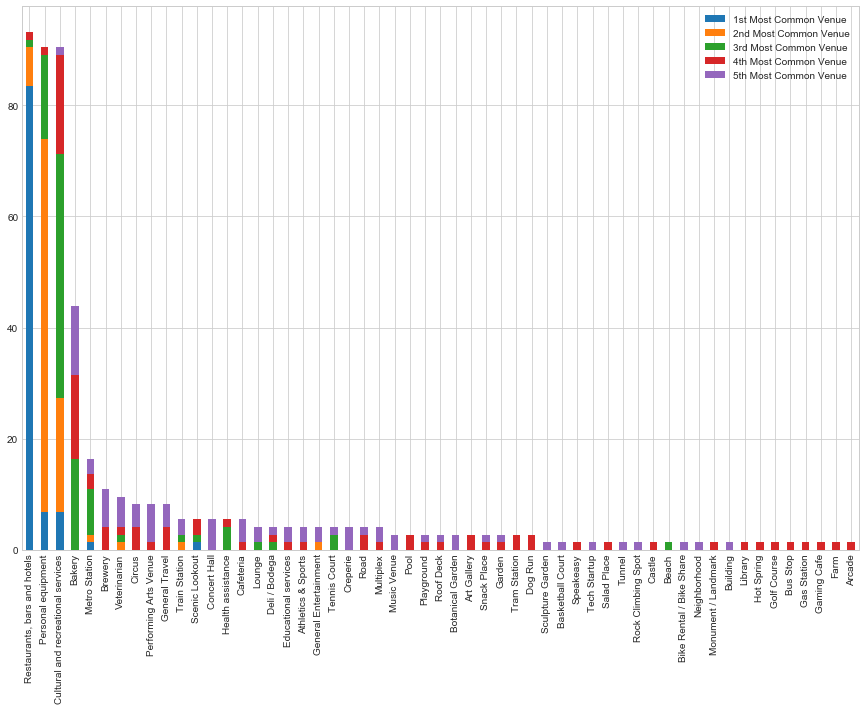

In [121]:
top_5 = create_ranking(df_venues_sorted,5)
       
top_5.plot(kind='bar', stacked=True, figsize=(15,10))

We can see easily how Foresquare is service oriented as mainly it returns restaurants, cultural and recreational services and personal equipment venues. Those are the ones more interesting for visitors.

### 4. Clustering
For clustering by commercial venues, we will use k-means algorithm.

In [122]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

In [123]:
# set number of clusters
kclusters = 10

bcn_foresquare_clustering = df_venues_sorted.drop('Neighborhood_ID', 1)

# run k-means clustering
kmeans = KMeans(init="random", n_clusters=kclusters, n_init=12).fit(bcn_commercial_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_

array([4, 0, 8, 0, 6, 4, 0, 6, 6, 4, 8, 7, 5, 2, 4, 5, 4, 4, 4, 6, 1, 5,
       4, 9, 4, 4, 4, 5, 3, 5, 4, 5, 6, 3, 5, 1, 3, 3, 5, 9, 1, 1, 5, 4,
       4, 3, 9, 5, 3, 3, 4, 5, 3, 9, 3, 3, 2, 1, 4, 4, 5, 6, 6, 4, 5, 6,
       8, 6, 0, 2, 6, 5, 5])

In [124]:
# Let's add the clustering labels to the general dataframe

df_BCN['Foresquare_ID'] = pd.DataFrame(kmeans.labels_+1,columns=['Commercial_ID'])

df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,...,Political_Bias,Political_Participation_ID,Political_Bias_ID,Household_income,Household_income_ID,Unemployed,Unemployment_%,Unemployment_ID,Commercial_ID,Foresquare_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,...,-0.41,3,2,15941.68,2,308229,8.47,6,5,5
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,...,-0.38,4,2,23755.79,4,85814,5.55,3,7,1
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,...,-0.46,4,2,17822.44,2,94286,8.32,6,4,9
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,...,-0.39,5,2,22255.66,3,130463,7.37,5,7,1
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,...,-0.27,9,4,23845.35,4,116683,5.34,3,5,7


#### Cluster 1

In [565]:
df_foresquare_clust_1 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 1,:]
df_foresquare_clust_1


,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,2,Personal equipment,"Restaurants, bars and hotels",Cultural and recreational services,Cocktail Bar,Bar,Speakeasy,Neighborhood,Health assistance,Bridge,Hotel
3,4,Personal equipment,"Restaurants, bars and hotels",Cultural and recreational services,Cocktail Bar,Hotel,Spa,Flea Market,Market,Massage Studio,Neighborhood
6,7,"Restaurants, bars and hotels",Hotel,Personal equipment,Bakery,Cultural and recreational services,Lounge,Roof Deck,Monument / Landmark,Spa,Flea Market
7,8,"Restaurants, bars and hotels",Personal equipment,Cocktail Bar,Hotel,Bakery,Lounge,Art Gallery,Creperie,Spa,Market
65,66,"Restaurants, bars and hotels",Cultural and recreational services,Hotel,Personal equipment,Bar,Art Gallery,Cafeteria,Concert Hall,Music Venue,Tram Station
68,69,"Restaurants, bars and hotels",Personal equipment,Hotel,Cultural and recreational services,Hotel Bar,Juice Bar,Concert Hall,Bakery,Multiplex,Cafeteria


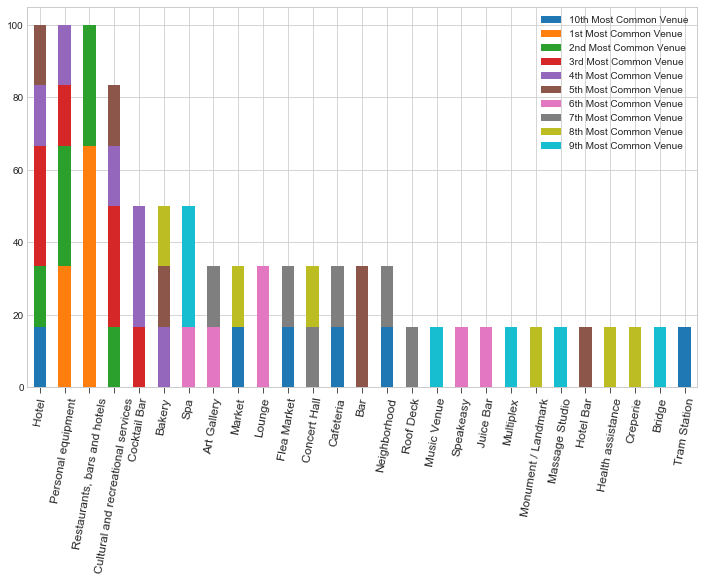

In [567]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_1 = create_ranking(df_foresquare_clust_1,10)

ranking_clust_f_1.plot(kind='bar', stacked=True, figsize=(12, 7))
plt.tick_params(axis="x", labelsize=12,labelrotation=80, length=6)

#### Cluster 2

In [568]:
df_foresquare_clust_2 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 2,:]
df_foresquare_clust_2.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
20,21,"Restaurants, bars and hotels",Cultural and recreational services,Tennis Court,Hotel,Trail,Bus Stop,Garden,Farm,Cultural Center,Deli / Bodega
35,36,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Deli / Bodega,Supermarket,Farmers Market,Creperie,Cultural Center,Dog Run,Educational services
41,42,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Bakery,Supermarket,Farmers Market,Creperie,Cultural Center,Deli / Bodega,Dog Run
46,47,"Restaurants, bars and hotels",Cultural and recreational services,Personal equipment,Supermarket,Farmers Market,Creperie,Cultural Center,Deli / Bodega,Dog Run,Educational services
57,58,"Restaurants, bars and hotels",Cultural and recreational services,Coworking Space,Creperie,Cultural Center,Deli / Bodega,Dog Run,Educational services,Farm,Farmers Market


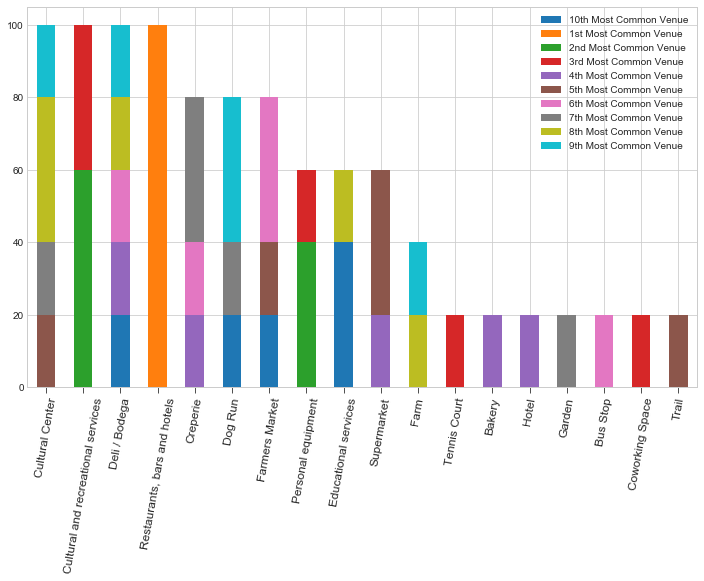

In [569]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_2 = create_ranking(df_foresquare_clust_2,10)

ranking_clust_f_2.plot(kind='bar', stacked=True, figsize=(12, 7))
plt.tick_params(axis="x", labelsize=12,labelrotation=80, length=6)

#### Cluster 3

In [570]:
df_foresquare_clust_3 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 3,:]
df_foresquare_clust_3.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
12,13,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Pool,Farmers Market,Concert Hall,Golf Course,Transportation Service,Bakery,Basketball Court
13,14,"Restaurants, bars and hotels",Cultural and recreational services,Personal equipment,Hotel,Art Gallery,Gay Bar,Bakery,Performing Arts Venue,Tennis Court,Supermarket
27,28,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Bakery,Hotel,Supermarket,Bar,Snack Place,Farm,Creperie
29,30,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Supermarket,Bar,Scenic Lookout,Mountain,Botanical Garden,Hotel,Market
31,32,"Restaurants, bars and hotels",Personal equipment,Bakery,Cultural and recreational services,Hotel,Bar,Supermarket,Lounge,Farmers Market,Scenic Lookout


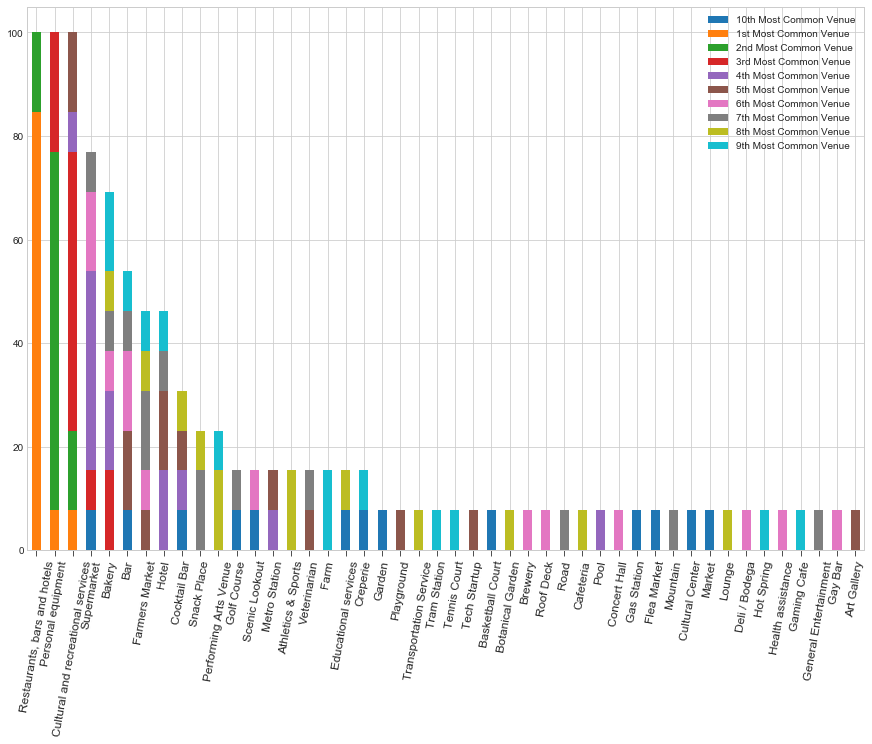

In [571]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_3 = create_ranking(df_foresquare_clust_3,10)

ranking_clust_f_3.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=12,labelrotation=80, length=6)

#### Cluster 4

In [572]:
df_foresquare_clust_4 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 4,:]
df_foresquare_clust_4.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
23,24,"Restaurants, bars and hotels",Hotel,Bar,Cultural and recreational services,Health assistance,Train Station,Bakery,Multiplex,Personal equipment,Educational services
39,40,"Restaurants, bars and hotels",Cultural and recreational services,Hotel,Tennis Court,Outdoor Sculpture,Metro Station,Farm,Personal equipment,Garden,Gaming Cafe
53,54,Cultural and recreational services,Metro Station,Personal equipment,Train Station,Veterinarian,Cultural Center,Deli / Bodega,Dog Run,Educational services,Farm


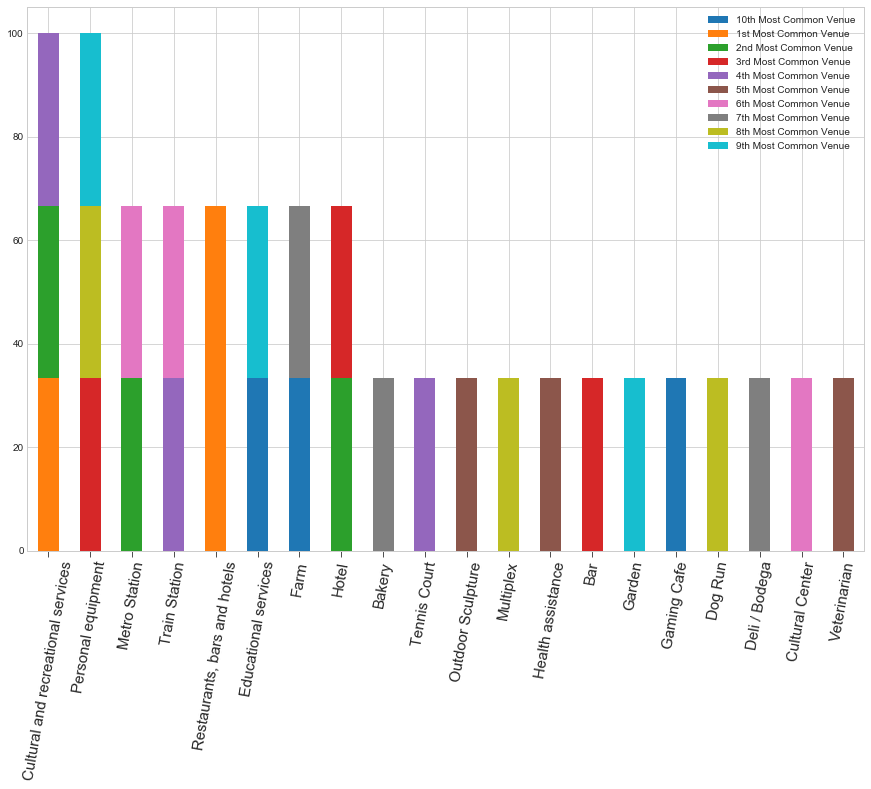

In [573]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_4 = create_ranking(df_foresquare_clust_4,10)

ranking_clust_f_4.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 5

In [574]:
df_foresquare_clust_5 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 5,:]
df_foresquare_clust_5.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,3,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Beach,Bakery,Bar,Cocktail Bar,Circus,Veterinarian,Farm
10,11,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Hotel,Bar,Cocktail Bar,Gay Bar,Brewery,Monument / Landmark,Sculpture Garden
66,67,"Restaurants, bars and hotels",Cultural and recreational services,Hotel,Bakery,Cocktail Bar,Beach,Deli / Bodega,Hookah Bar,Hotel Bar,Karaoke Bar


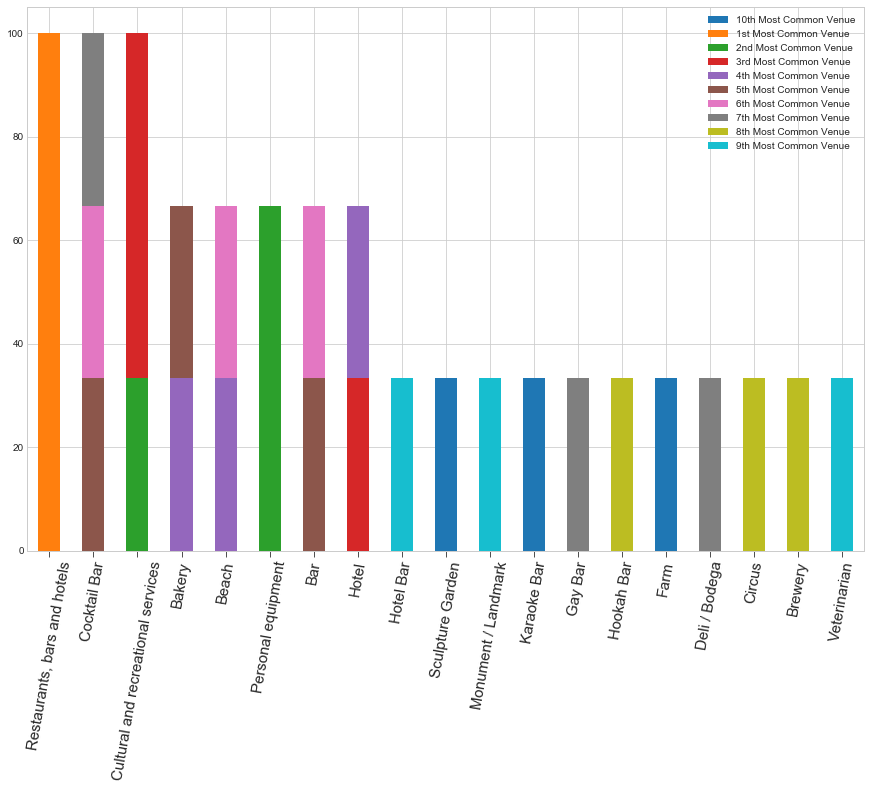

In [575]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_5 = create_ranking(df_foresquare_clust_5,10)

ranking_clust_f_5.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 6

In [576]:
df_foresquare_clust_6 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 6,:]
df_foresquare_clust_6.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
15,16,"Restaurants, bars and hotels",Cultural and recreational services,Personal equipment,Hotel,Supermarket,Platform,Music Venue,Metro Station,Performing Arts Venue,Bar
19,20,"Restaurants, bars and hotels",Cultural and recreational services,Personal equipment,Hotel,Garden,Educational services,Cocktail Bar,Athletics & Sports,Bakery,Tram Station
21,22,Personal equipment,Veterinarian,Hot Spring,Cultural Center,Cultural and recreational services,Deli / Bodega,Dog Run,Educational services,Farm,Farmers Market
32,33,"Restaurants, bars and hotels",Cultural and recreational services,Personal equipment,Supermarket,Bakery,Farmers Market,Bar,Metro Station,Deli / Bodega,Scenic Lookout
38,39,Scenic Lookout,Supermarket,Veterinarian,Farmers Market,Creperie,Cultural Center,Cultural and recreational services,Deli / Bodega,Dog Run,Educational services


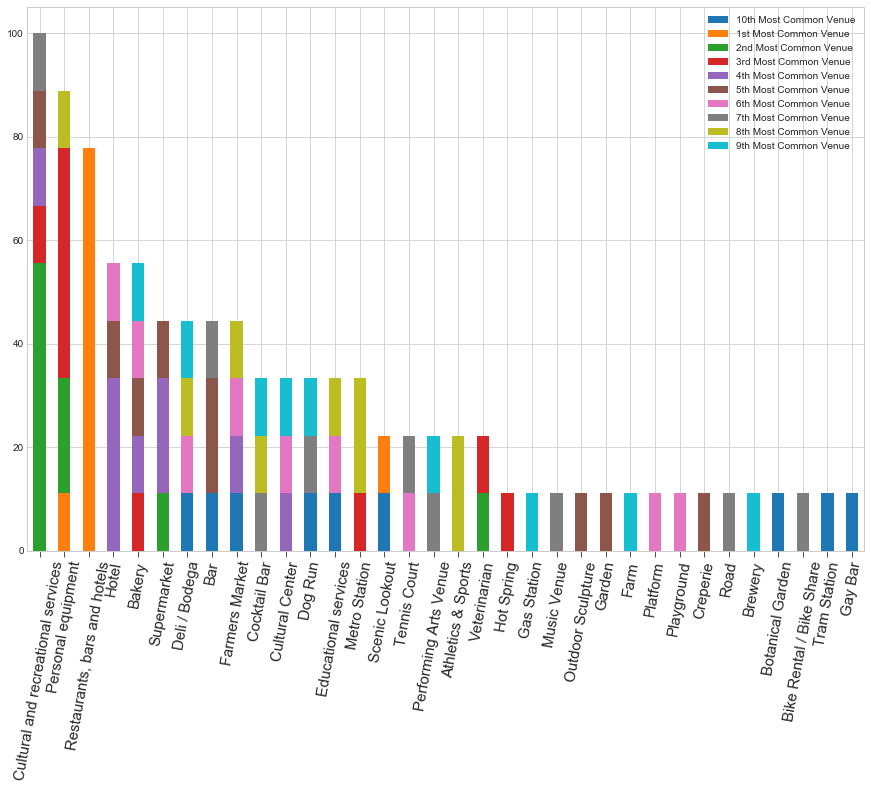

In [577]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_6 = create_ranking(df_foresquare_clust_6,10)

ranking_clust_f_6.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 7

In [579]:
df_foresquare_clust_7 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 7,:]
df_foresquare_clust_7.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,1,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Cocktail Bar,Bar,Garden,Market,Roof Deck,Gay Bar,Deli / Bodega
4,5,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Hotel,Juice Bar,Concert Hall,Bakery,Gaming Cafe,Deli / Bodega,Dog Run
5,6,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Hotel,Bakery,General Travel,Market,Brewery,Farm,Cultural Center
8,9,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Brewery,Bakery,Supermarket,Hotel,Scenic Lookout,Lounge,Snack Place
9,10,"Restaurants, bars and hotels",Personal equipment,Bar,Cultural and recreational services,Hotel,Supermarket,Market,Flea Market,Cocktail Bar,Bike Rental / Bike Share


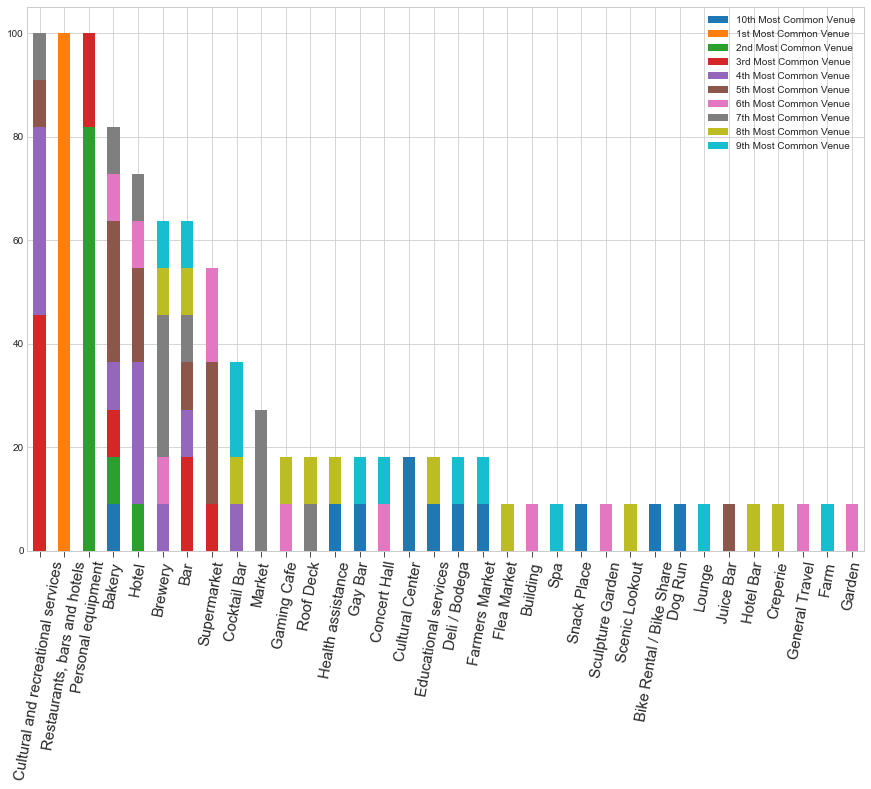

In [580]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_7 = create_ranking(df_foresquare_clust_7,10)

ranking_clust_f_7.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 8

In [586]:
df_foresquare_clust_8 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 8,:]
df_foresquare_clust_8

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
28,29,"Restaurants, bars and hotels",Hotel,Personal equipment,Cultural and recreational services,Gas Station,Metro Station,Gay Bar,Garden,Gaming Cafe,Flea Market
33,34,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Scenic Lookout,Pool,Bar,Basketball Court,Educational services,Creperie,Cultural Center
36,37,Cultural and recreational services,"Restaurants, bars and hotels",Scenic Lookout,Personal equipment,Bakery,Pool,Botanical Garden,Mountain,Educational services,Creperie
37,38,"Restaurants, bars and hotels",Personal equipment,Metro Station,Spa,Cultural and recreational services,Bus Station,Playground,Bakery,Bar,Farmers Market
45,46,"Restaurants, bars and hotels",Cultural and recreational services,Personal equipment,Supermarket,Cocktail Bar,Gay Bar,Gas Station,Garden,General Entertainment,Gaming Cafe
48,49,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Market,Hot Spring,Farmers Market,Cultural Center,Deli / Bodega,Dog Run,Educational services
49,50,Cultural and recreational services,Castle,General Entertainment,Metro Station,Veterinarian,Flea Market,Deli / Bodega,Dog Run,Educational services,Farm
52,53,"Restaurants, bars and hotels",Metro Station,Music Venue,Personal equipment,Cultural and recreational services,Health assistance,Garden,Gaming Cafe,Flea Market,Farmers Market
54,55,Metro Station,Cultural and recreational services,Personal equipment,"Restaurants, bars and hotels",Supermarket,Creperie,Cultural Center,Deli / Bodega,Dog Run,Educational services
55,56,Cultural and recreational services,Metro Station,Train Station,Flea Market,Cultural Center,Deli / Bodega,Dog Run,Educational services,Farm,Farmers Market


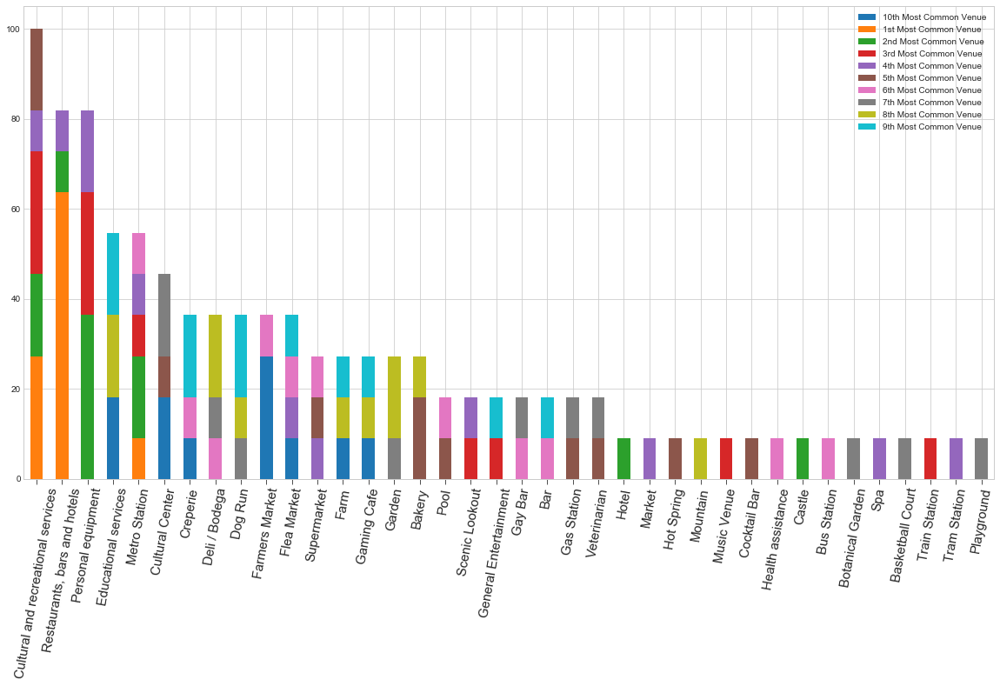

In [587]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_8 = create_ranking(df_foresquare_clust_8,10)

ranking_clust_f_8.plot(kind='bar', stacked=True, figsize=(20, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

#### Cluster 9

In [583]:
df_foresquare_clust_9 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 9,:]
df_foresquare_clust_9.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
11,12,"Restaurants, bars and hotels",Personal equipment,Tennis Court,Supermarket,Flea Market,Educational services,Coworking Space,Creperie,Cultural Center,Cultural and recreational services


#### Cluster 10

In [584]:
df_foresquare_clust_10 = df_venues_sorted.loc[df_BCN['Commercial_ID'] == 10,:]
df_foresquare_clust_10.head()

,Neighborhood_ID,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
18,19,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Pool,Tech Startup,Deli / Bodega,Garden,Cocktail Bar,Bar,Gas Station
22,23,"Restaurants, bars and hotels",Personal equipment,Bakery,Cultural and recreational services,Hotel,Cocktail Bar,Market,Train Station,Tunnel,Gay Bar
24,25,"Restaurants, bars and hotels",Personal equipment,Bakery,Cultural and recreational services,Bar,Train Station,Supermarket,Multiplex,Farmers Market,Educational services
25,26,"Restaurants, bars and hotels",Personal equipment,Cultural and recreational services,Bakery,Hotel,Snack Place,Garden,Market,Deli / Bodega,Health assistance
26,27,"Restaurants, bars and hotels",Personal equipment,Bakery,Sports Bar,Cultural and recreational services,Deli / Bodega,Educational services,Hotel,Garden,Gas Station


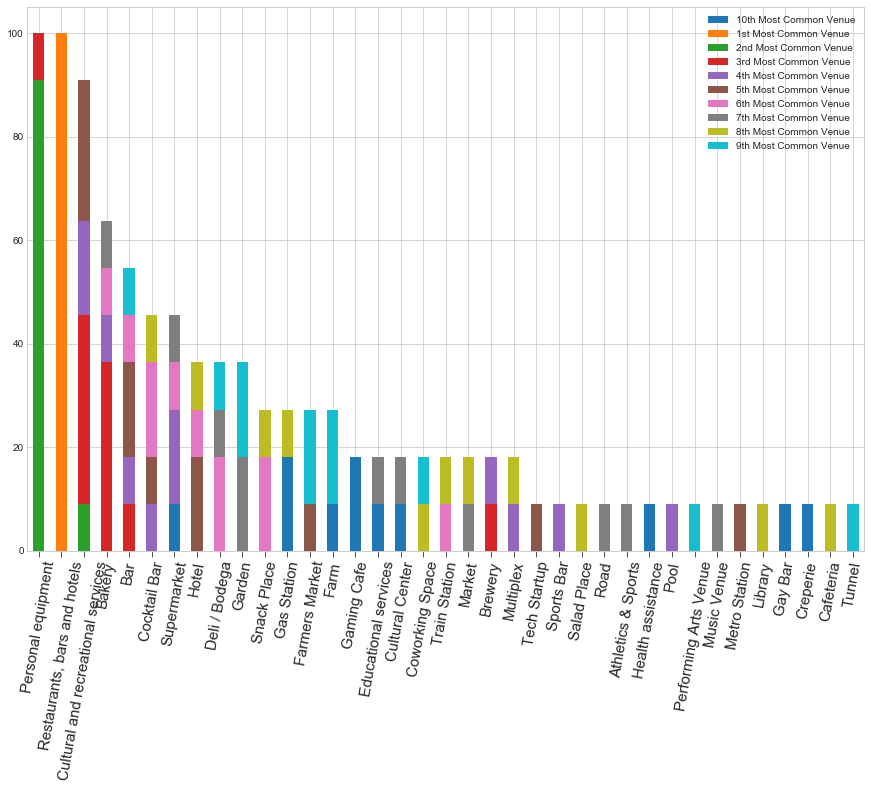

In [585]:
# let's use the function created previously to visually find the present categories
ranking_clust_f_10 = create_ranking(df_foresquare_clust_10,10)

ranking_clust_f_10.plot(kind='bar', stacked=True, figsize=(15, 10))
plt.tick_params(axis="x", labelsize=15,labelrotation=80, length=6)

We will classify the clusters in a tree manner, so that **all the neighborhoods in the cluster** satisfy that in their top 10 of most frequent commercial venue categories:

* A: Top 1 is 'Restaurants, bars and hotels':
 - A.1: Top 2 is 'Supermarkets and consumable stores':
   * Cluster 4: 'Education services' between top 3 and top 5. 'Health assistance' between top 5 and top 7. All contain 'Culture and leisure stores' from top 5, 'Personal equipment stores' from top 7 and 'Finantial and insurance services' from top 8.
   * Cluster 10: 'Home appliances and car repairing' from and mainly as top 3, 'Education services' between top 4 and 5, and all contain 'Finantial and insurance services' and 'Health assistance' in the top 10.
 - A.2: Top 2 and top 3 contain 'Supermarkets and consumable stores' and 'Personal equipment stores':
   * Cluster 5: 'Household items' between top 4 and top 5. 'Culture and leisure stores' between top 7 and top 8. All contain 'Education services' from top 5, 'Finantial and insurance services' from top 6 and 'Home appliances and car repairing' from top 9.
   * Cluster 9: **Contains 'Cultural and recreational services'** in their top 10. Also all contain,'Household items', 'Health assistance' and 'Culture and leisure stores' from top 4.
* B: Top 1 is 'Supermarkets and consumable stores' and top 2 is 'Restaurants, bars and hotels':
 - Cluster 2: 'Personal equipment stores' is top 3 and 'Education services' between top 3 and top 5. 'Health assistance' between top 4 and top 5, and 'Household items' from top 6.
 - Cluster 3: 'Personal equipment stores' between top 3 and 5. 'Household items' between top 4 and 7. 'Health assistance' and 'Home appliances and car repairing' between top 6 and 8.'Education services' from the top 5.
 - Cluster 7: 'Education services' between top 3 and 4. 'Health assistance' between top 3 and top 6.'Home appliances and car repairing' between top 4 and 8.
* Cluster 1: This cluster has just one neighborhood, which has 'Home appliances and car repairing' as top 1, hotels as top 2 and car vendor as top 3. Two of the top3 are automobile related, so this cluster can be defined by that.
* Cluster 6: The top 1 and 2 are shared by 'Restaurants, bars and hotels' and 'Supermarkets and consumable stores'. 'Health assistance' between top 5 and top 6. 'Household items' between top 4 and 7, 'Culture and leisure stores' from top 4, and 'Education services' between top 3 and top 9, mainly in top 7.
* Cluster 8: **Contains 'Real estate'** in their top 10. The top 1, 2 and 3 are shared by 'Restaurants, bars and hotels', 'Supermarkets and consumable stores' and 'Personal equipment stores'. Als contains 'Health assistance' between top 3 and top 6, and 'Finantial and insurance services' between top 5 and top 9.

### 5. Visual representation


In [125]:
bcn_foresquare_map = choropleth_map(bcn_geo,'Foresquare_ID',latitude,longitude)
bcn_foresquare_map

## COVID-19 scope<a name="covid"></a>

This scope will analyze the covid positive cases distribution in the city of Barcelona.


### 1. Data obtention. 
We will use the information provided at https://aspb.shinyapps.io/COVID19_BCN/ by the public administration, that shows all the positive cases of COVID-19 by neighborhood at date April 19th 2020.

In [126]:
excel_path_covid= 'https://github.com/IanRiera/Coursera_Capstone/blob/master/Final_Project/BCN_COVID.xlsx?raw=true'

# panda includes a function to read excel files
df_covid = pd.read_excel(excel_path_covid)

df_covid.head()

,District,Neighborhood_ID,Neighborhood_name,Covid_positives
0,1,1,el Raval,181
1,1,2,el Barri Gòtic,51
2,1,3,la Barceloneta,76
3,1,4,"Sant Pere, Santa Caterina i la Ribera",62
4,2,5,el Fort Pienc,151


### 2. Data processing
In this case we already have prepared the data properly in the excel sheet, so no further processing is required.

### 3. Data analysis
First we can calculate and add the anual average unemployed to the general table. 

In [127]:
df_BCN["Covid_positives"] = df_covid["Covid_positives"]

df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,...,Political_Participation_ID,Political_Bias_ID,Household_income,Household_income_ID,Unemployed,Unemployment_%,Unemployment_ID,Commercial_ID,Foresquare_ID,Covid_positives
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,...,3,2,15941.68,2,308229,8.47,6,5,5,181
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,...,4,2,23755.79,4,85814,5.55,3,7,1,51
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,...,4,2,17822.44,2,94286,8.32,6,4,9,76
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,...,5,2,22255.66,3,130463,7.37,5,7,1,62
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,...,9,4,23845.35,4,116683,5.34,3,5,7,151


In [128]:
max_covid = int(df_BCN['Covid_positives'].max())
max_covid_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Covid_positives'].idxmax(axis = 0)])

min_covid = int(df_BCN['Covid_positives'].min())
min_covid_hood = str(df_BCN['Neighborhood_name'].iloc[df_BCN['Covid_positives'].idxmin(axis = 0)])

print("The neighborhood with more positive cases of Covid-19 in Barcelona is{} with {:d} diagnosed cases. ".format(max_covid_hood, max_covid))
print("The neighborhood with more positive cases of Covid-19 in Barcelona is{} with {:d} diagnosed cases. ".format(min_covid_hood, min_covid))

The neighborhood with more positive cases of Covid-19 in Barcelona is Sant Andreu with 384 diagnosed cases. 
The neighborhood with more positive cases of Covid-19 in Barcelona is la Clota with 1 diagnosed cases. 


### 4. Clustering
Clustering by Covid positive cases.

In [129]:
# split the data range into 10 bins
df_BCN['Covid_ID'], imm_bins = pd.cut(np.asarray(df_BCN['Covid_positives']),10,labels=np.arange(1,11), retbins=True)
df_bins['Covid_positives'] = imm_bins[:10].astype(int)
df_BCN.head()


,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,...,Political_Bias_ID,Household_income,Household_income_ID,Unemployed,Unemployment_%,Unemployment_ID,Commercial_ID,Foresquare_ID,Covid_positives,Covid_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,...,2,15941.68,2,308229,8.47,6,5,5,181,5
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,...,2,23755.79,4,85814,5.55,3,7,1,51,2
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,...,2,17822.44,2,94286,8.32,6,4,9,76,2
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,...,2,22255.66,3,130463,7.37,5,7,1,62,2
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,...,4,23845.35,4,116683,5.34,3,5,7,151,4


### 5. Visual representation
The choropleth map is created, being yellow the youngest and red the eldest.

In [130]:
bcn_covid_map = choropleth_map(bcn_geo,'Covid_ID',latitude,longitude)
bcn_covid_map

In [131]:
df_bins[['Bin_ID','Covid_positives']]

,Bin_ID,Covid_positives
0,1,0
1,2,39
2,3,77
3,4,115
4,5,154
5,6,192
6,7,230
7,8,269
8,9,307
9,10,345


## Methodology <a name="methodology"></a>

All the effort on analyzing and **segmenting** the city of Barcelona into the previous steps, was the preparation for the real goal, which is finding the correlations among them.

So after **clustering** the city based on different parameters, we will use these values to calculate the correlation **heatmap** with seaborn and the **scatter plot** will be calculated for the high absolute value correlations.

This plots will set a base for in future development of the project, create **regression models** and predictions from it.

## Results and Discussion <a name="results"></a>

In [132]:
import seaborn as sns

In [133]:
pd.set_option('display.max_columns', None)
df_BCN.head()

,District,Neighborhood_ID,Neighborhood_name,Population,Population_%,Population_ID,Mean_age,Age_ID,Immigrants,Immigration_%,Immigration_ID,Political_Participation_%,Political_Bias,Political_Participation_ID,Political_Bias_ID,Household_income,Household_income_ID,Unemployed,Unemployment_%,Unemployment_ID,Commercial_ID,Foresquare_ID,Covid_positives,Covid_ID
0,1,1,el Raval,47353,2.89,9,38,1,24199,51.0,10,48.68,-0.41,3,2,15941.68,2,308229,8.47,6,5,5,181,5
1,1,2,el Barri Gòtic,18629,1.14,4,39,1,10254,55.0,10,54.62,-0.38,4,2,23755.79,4,85814,5.55,3,7,1,51,2
2,1,3,la Barceloneta,14857,0.91,3,43,5,5612,38.0,7,54.36,-0.46,4,2,17822.44,2,94286,8.32,6,4,9,76,2
3,1,4,Sant Pere. Santa Caterina i la Ribera,22590,1.38,4,40,2,9852,44.0,8,57.68,-0.39,5,2,22255.66,3,130463,7.37,5,7,1,62,2
4,2,5,el Fort Pienc,32349,1.98,6,44,6,7827,24.0,4,70.08,-0.27,9,4,23845.35,4,116683,5.34,3,5,7,151,4


In [134]:
df_BCN_corr = df_BCN[['Population_%','Mean_age','Immigration_%','Political_Participation_%','Political_Bias', 'Household_income','Unemployment_%', 'Commercial_ID', 'Foresquare_ID', 'Covid_positives']]
df_BCN_corr.corr()

,Population_%,Mean_age,Immigration_%,Political_Participation_%,Political_Bias,Household_income,Unemployment_%,Commercial_ID,Foresquare_ID,Covid_positives
Population_%,1.000000,0.183885,0.148453,0.433314,0.220192,0.216917,-0.299988,-0.084121,0.047534,0.861374
Mean_age,0.183885,1.000000,-0.548688,0.430930,0.128711,-0.054105,-0.078783,0.084980,0.169473,0.386913
Immigration_%,0.148453,-0.548688,1.000000,-0.366106,-0.228091,-0.101173,0.151925,-0.132940,-0.214901,-0.013460
Political_Participation_%,0.433314,0.430930,-0.366106,1.000000,0.583941,0.672601,-0.714669,-0.077301,0.037750,0.327327
Political_Bias,0.220192,0.128711,-0.228091,0.583941,1.000000,0.881645,-0.604152,-0.083438,0.004632,-0.006821
Household_income,0.216917,-0.054105,-0.101173,0.672601,0.881645,1.000000,-0.779832,-0.270247,-0.052742,-0.064991
Unemployment_%,-0.299988,-0.078783,0.151925,-0.714669,-0.604152,-0.779832,1.000000,0.232993,-0.022641,-0.080238
Commercial_ID,-0.084121,0.084980,-0.132940,-0.077301,-0.083438,-0.270247,0.232993,1.000000,-0.154318,0.031736
Foresquare_ID,0.047534,0.169473,-0.214901,0.037750,0.004632,-0.052742,-0.022641,-0.154318,1.000000,0.045029
Covid_positives,0.861374,0.386913,-0.013460,0.327327,-0.006821,-0.064991,-0.080238,0.031736,0.045029,1.000000


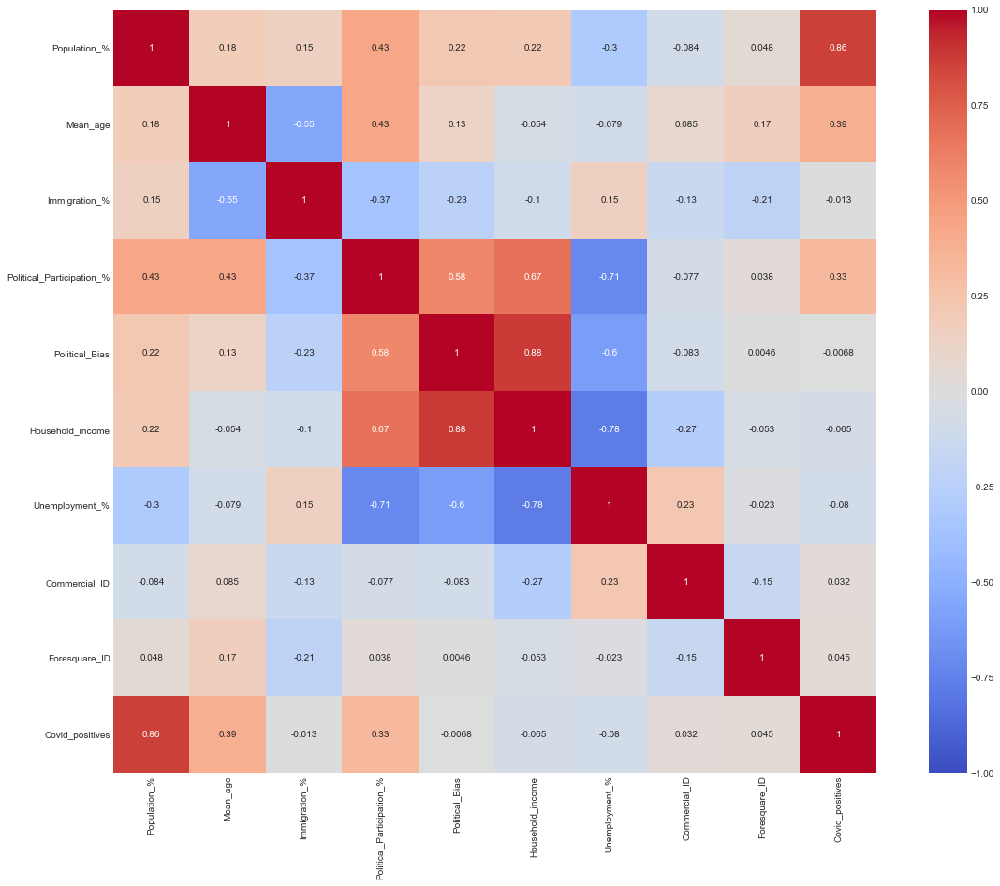

In [135]:
plt.subplots(figsize=(20,15))
sns.heatmap(df_BCN_corr.corr(), annot = True, vmin=-1, vmax=1, center= 0,square= True, cmap= 'coolwarm')

By category and considering correlations absolute values over 0.5, we can observe:
* Population %: Logically, we observe a high correlation with the amount of positive cases in covid. 
* Mean_age: There is a weak negative correlation between mean age and immigration %. 
* Political Participation: We can see a mild correlation of political participation with political bias and household income. There is also a negative correlation with unemployment %.
* Political bias: There is a high correlation between the political bias and the household income. There is also a negative correlation with unemployment %. 
* Household income: In addition to the already mentioned, there is a logical strong negative correlation with the unemployment %.

* In terms of Foresquare in relation to official data, there is absolute non correlation, and therefore we can discard Foresquare as a good option for clustering and representing the city.

Now let's see the scatter plots of the mentioned correlations.

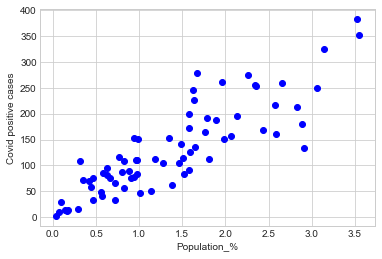

In [136]:
# Population % and covid
plt.scatter(df_BCN_corr['Population_%'], df_BCN_corr['Covid_positives'],  color='blue')
plt.xlabel("Population_%")
plt.ylabel("Covid positive cases")
plt.show()

We can observe almost a lineal relationship. A polinomial regression or non linear regression could make a good fit. To do task for the continuation of this project.

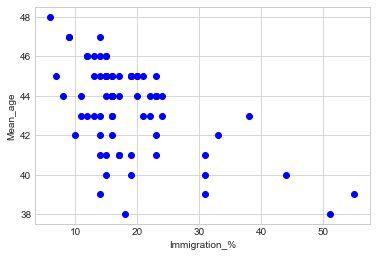

In [137]:
# Mean age and immigration
plt.scatter(df_BCN_corr['Immigration_%'], df_BCN_corr['Mean_age'],  color='blue')
plt.xlabel("Immigration_%")
plt.ylabel("Mean_age")
plt.show()

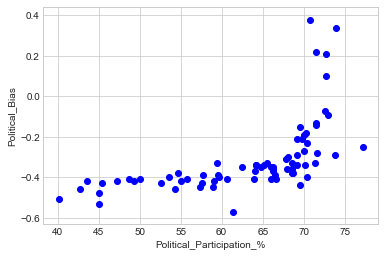

In [617]:
# Political participation vs bias
plt.scatter(df_BCN_corr['Political_Participation_%'], df_BCN_corr['Political_Bias'],  color='blue')
plt.xlabel("Political_Participation_%")
plt.ylabel("Political_Bias")
plt.show()

We can observe that when participation increases, the bias falls to the right wing. An exponencial o logistic functions would provide a good fit.

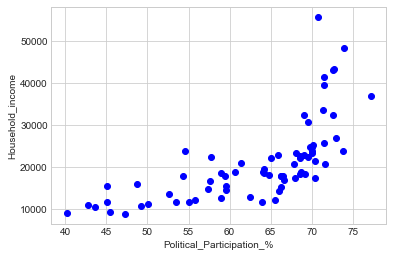

In [618]:
# Political participation vs household income
plt.scatter(df_BCN_corr['Political_Participation_%'], df_BCN_corr['Household_income'],  color='blue')
plt.xlabel("Political_Participation_%")
plt.ylabel("Household_income")
plt.show()

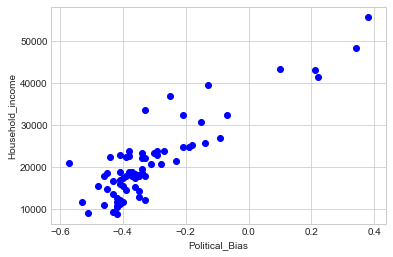

In [619]:
# Political bias vs household income
plt.scatter(df_BCN_corr['Political_Bias'], df_BCN_corr['Household_income'],  color='blue')
plt.xlabel("Political_Bias")
plt.ylabel("Household_income")
plt.show()

We can see a clear tendency to the right wing ideology as the household income increases. A non busted myth. We can observe, as there is a slightly lineal relationship between the political bias and household income, the graphic between the participation and household follows the same shape than the one between bias and participation.

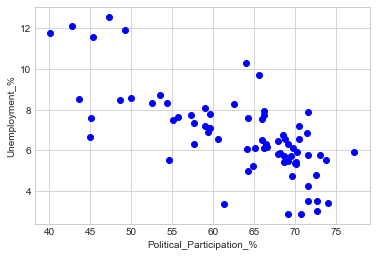

In [620]:
# Political participation vs unemployment
plt.scatter(df_BCN_corr['Political_Participation_%'], df_BCN_corr['Unemployment_%'],  color='blue')
plt.xlabel("Political_Participation_%")
plt.ylabel("Unemployment_%")
plt.show()

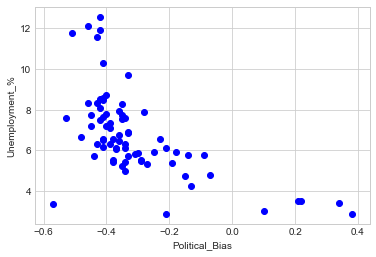

In [621]:
# Political bias vs unemployment
plt.scatter(df_BCN_corr['Political_Bias'], df_BCN_corr['Unemployment_%'],  color='blue')
plt.xlabel("Political_Bias")
plt.ylabel("Unemployment_%")
plt.show()

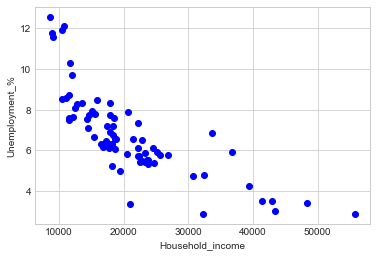

In [622]:
# household income vs unemployment
plt.scatter(df_BCN_corr['Household_income'], df_BCN_corr['Unemployment_%'],  color='blue')
plt.xlabel("Household_income")
plt.ylabel("Unemployment_%")
plt.show()

And as one would imagine, the increasement in unemployment generates a decrease in household income. And we found a relationship between political bias and household income, being the rich right winged and the not that rich left winged. And the first correlation we observed was that bias was related to participation. All in all, we find that unemployment and household income, and political participation and bias are correlated and could be modeled for prediction with nonlinear regression functions.

## Conclusion <a name="conclusion"></a>

This analysis shows that the city of Barcelona can hardly be clustered based in all the demographic parameters, as for each of them you get a different painting. However, a correlation was found between the tuple household income and unemployment, the political participation and the political bias.

With this correlations, a modelling could be applied so, for example, a political party could estimate the potential amount of votes that could get in each neighborhood.  

In terms of the suitability of Foursquare to cluster a city, it proved to missrepresent the reality of the city, providing a useful tool for tourists and other visitors, or even for local citizens leisure time. 

This project aims to be repeated step by step next year to observe the effects of coronavirus. 